In [1]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from scipy import stats
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
from matplotlib.lines import Line2D
import numpy as np
import re

def plot_reg(label1, label2, df, row=0, col=0, ind=0, save = False,dir = 'corr_fig_approach'):
    """
    Plots a regression scatter plot with rho and p-value displayed.

    Args:
        label1: The first name column of data as a Pandas Series.
        label1: The second name column of data as a Pandas Series.
    """

    # behdata1 = behdata.dropna(subset=['SBSOD','D1_neg_social_cosine_distance_error'])


    df_dropped = df.dropna(subset=[label1,label2])
    df1 = df_dropped[label1]
    df2 = df_dropped[label2]


    if row != 0:
        plt.subplot(row, col, ind)

    rho, p_value = pearsonr(df1, df2)

    # 根据 p 值添加星号
    if p_value <= 0.0001:
        stars = "****"
    elif p_value <= 0.001:
        stars = "***"
    elif p_value <= 0.01:
        stars = "**"
    elif p_value <= 0.05:
        stars = "*"
    else:
        stars = ""

    sns.set_theme(style="whitegrid",font_scale=1.2)

    g = sns.regplot(x=df1, y=df2, 
                    color='#F98F34', 
                    marker='o',
                    scatter_kws={'s': 60,'color':'#F98F34'},
                    line_kws={'color':'#3B549D'},#设置线属性，参考 plt.
                    truncate=False,#让拟合线与轴相交
                    )

    plt.text(0.95, 0.95, f'rho: {rho:.2f}\n p-value: {p_value:.4f}{stars}',
             horizontalalignment='right',
             verticalalignment='top',
             transform=plt.gca().transAxes)
    
    if save:
        plt.savefig(dir+'/'+label1+'_'+label2+'.svg', dpi=1000)
    else:
        plt.show()
    plt.clf()  # 清除当前图形，以避免叠加效果


def plot_reg_diff(label1, label2, data1, data2, save = False):
    """
    Plots a regression scatter plot with rho and p-value di
    elayed.
    Variables in Different table

    Args:
        label1: The first name column of data as a Pandas Series.
        label1: The second name column of data as a Pandas Series.
    """
    df1 = data1[label1]
    df2 = data2[label2]

    rho, p_value = pearsonr(df1, df2)
    sns.set_theme(style="whitegrid",font_scale=1.2)

    g = sns.regplot(x=df1, y=df2, 
                    color='g', 
                    marker='o',
                    scatter_kws={'s': 60,'color':'g',},
                    line_kws={'color':'#000000'},#设置线属性，参考 plt.
                    truncate=False,#让拟合线与轴相交
                    )

    plt.text(0.95, 0.95, f'rho: {rho:.2f}\np-value: {p_value:.3f}',
             horizontalalignment='right',
             verticalalignment='top',
             transform=plt.gca().transAxes)

    if save:
        plt.savefig('corr_fig/'+label1+'_'+label2+'.svg', dpi=900)
    else:
        plt.show()
    plt.clf()  # 清除当前图形，以避免叠加效果


from scipy.stats import pearsonr,spearmanr
def convert_pvalue_to_asterisks(pvalue):

    # return pvalue

    if pvalue <= 0.0001:
        return "****"
    elif pvalue <= 0.001:
        return "***"
    elif pvalue <= 0.01:
        return "**"
    elif pvalue <= 0.05:
        return "*"
    return ""

def corr_sig(df=None, dx=0.5, dy=0.75):
# 计算相关性显著性

    for feature1 in df.columns:
        for feature2 in df.columns:
            if df.columns.to_list().index(feature1) > df.columns.to_list().index(feature2):
                if feature1 != feature2:

                    df_filled = df[[feature1, feature2]].fillna(df.mean())

                    corr_value, p_value = pearsonr(df_filled[feature1], df_filled[feature2]) # fill out empty data using avg value
                    
                    asterisks = convert_pvalue_to_asterisks(p_value)
                    plt.text(
                        df.columns.get_loc(feature2) + dx,
                        df.columns.get_loc(feature1) + dy,
                        asterisks,
                        ha="center",
                        va="center",
                        color = 'white',
                        fontsize=14,
                           
                    )
    return corr_value, p_value

def plot_heatmap(df: pd.DataFrame, title:str, location:str=None, x=20, y=12):
    corr = df.corr()
    fig, ax = plt.subplots(figsize=(x, y))
    mask = np.triu(np.ones_like(corr, dtype=bool))
    sns.heatmap(corr, annot=True, mask=mask, fmt=".2g", linewidths=.8, ax=ax, cmap='viridis', 
                annot_kws={"fontsize": 12})
    corr_sig(df)
    plt.title(title+ ' N='+str(len(df)))
    # plt.savefig('Correlation_Matrix_of_Questionnaire_and_Navigation_Ability.svg',dpi=600)
    if location == None:
        plt.show()
    else:
        plt.savefig(location+'.svg', dpi=600)

def significance_label(p):
    if p < 0.001:
        return '***'
    elif p < 0.01:
        return '**'
    elif p < 0.05:
        return '*'
    else:
        return ''

# 绘制显著性矩阵热度图

def draw_corr(beh_df, neu_df, dx=.63, dy=.5, location=None, showfig = True):

    merged_df = pd.merge(beh_df, neu_df, on='sub_ID')
    # .dropna()
    if showfig:
        plot_heatmap(merged_df, 'Heatmap 1 ', location=location)
    corr_matrix = merged_df.corr()


    beh_columns = beh_df.columns.to_list().copy()
    neu_columns = neu_df.columns.to_list().copy()
    beh_columns.remove('sub_ID')
    neu_columns.remove('sub_ID')


    sub_corr_matrix = corr_matrix.loc[beh_columns, neu_columns]
    # 使用seaborn绘制热度图
    # plt.figure(figsize=(8, 10))

    # sns.heatmap(sub_corr_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
    # corr_sig(sub_corr_matrix, dx,dy)
    # plt.title('Correlation Heatmap')
    # plt.show()

    # sns.heatmap(sub_corr_matrix.astype(float), annot=sub_corr_matrix.applymap(significance_label), fmt="", linewidths=.8, cmap='coolwarm', cbar=False)
    # plt.title('P-Value Significance Matrix')

    return merged_df

def generate_corrmap(df1, df2, list1, list2, dx= .63, dy=.5, location = None, showfig=True):
    
    df_cut = df1.loc[:,list1]
    df_cut2 = df2.loc[:,list2]

    # draw_corr(df_cut, df_cut2, dx,dy, location=location, showfig=showfig)

    return draw_corr(df_cut, df_cut2, dx,dy, location=location,showfig=showfig)


def plot_reg_double_y(x_label, y1_label, y2_label, df, save=False, dir='corr_fig_approach'):
    """
    绘制具有两个y轴的回归散点图，显示两个rho和p值。

    Args:
        x_label: x轴的数据列名 (A/C).
        y1_label: 第一个y轴的数据列名 (B).
        y2_label: 第二个y轴的数据列名 (D).
        df: 包含数据的Pandas DataFrame。
        save: 是否保存图像，默认为False。
        dir: 保存图像的目录，默认为'corr_fig_approach'。
    """

    df_dropped = df.dropna(subset=[x_label, y1_label, y2_label])
    x = df_dropped[x_label]
    y1 = df_dropped[y1_label]
    y2 = df_dropped[y2_label]

    rho1, p_value1 = pearsonr(x, y1)
    rho2, p_value2 = pearsonr(x, y2)

    # 星号标记函数
    def get_stars(p_value):
        if p_value <= 0.0001:
            return "****"
        elif p_value <= 0.001:
            return "***"
        elif p_value <= 0.01:
            return "**"
        elif p_value <= 0.05:
            return "*"
        else:
            return ""

    stars1 = get_stars(p_value1)
    stars2 = get_stars(p_value2)

    fig, ax1 = plt.subplots(figsize=(8, 6)) # 创建主轴

    sns.set_theme(style="whitegrid", font_scale=1.2)

    # 绘制第一个回归图 (y1)
    sns.regplot(x=x, y=y1,
                color='blue',
                marker='o',
                scatter_kws={'s': 60, 'color': '#4169E1'},
                line_kws={'color': 'blue'}, #保持颜色一致
                truncate=False,
                ax=ax1)

    ax1.set_xlabel(x_label)
    ax1.set_ylabel(y1_label, color='blue') #设置y轴标签颜色与线条一致
    ax1.tick_params(axis='y', labelcolor='blue') #设置y轴刻度颜色与线条一致

    # 创建第二个y轴
    ax2 = ax1.twinx()

    # 绘制第二个回归图 (y2)
    sns.regplot(x=x, y=y2,
                color='red',
                marker='x',
                scatter_kws={'s': 60, 'color': '#DC143C'}, #深红色
                line_kws={'color': 'red'}, #保持颜色一致
                truncate=False,
                ax=ax2)
    ax2.set_ylabel(y2_label, color='red') #设置y轴标签颜色与线条一致
    ax2.tick_params(axis='y', labelcolor='red') #设置y轴刻度颜色与线条一致

    # 添加文本信息，调整位置以避免重叠
    ax1.text(0.05, 0.95, f'rho: {rho1:.2f}\n p-value: {p_value1:.4f}{stars1}',
            horizontalalignment='left',
            verticalalignment='top',
            transform=ax1.transAxes, color='blue') #文本颜色与线条一致
    ax2.text(0.95, 0.95, f'rho: {rho2:.2f}\n p-value: {p_value2:.4f}{stars2}',
            horizontalalignment='right',
            verticalalignment='top',
            transform=ax2.transAxes,color='red') #文本颜色与线条一致

    plt.tight_layout()

    if save:
        plt.savefig(dir + '/' + x_label + '_' + y1_label + '_' + y2_label + '.svg', dpi=900)
    else:
        plt.show()
    plt.clf()

# 示例数据 (A=C)
# np.random.seed(0)
# data = {'A': np.random.rand(100), 'B': np.random.rand(100), 'C': np.random.rand(100), 'D': np.random.rand(100)}
# df = pd.DataFrame(data)
# df['C'] = df['A'] #使A=C

# plot_reg_double_y('A', 'B', 'D', df, save=False)
# plot_reg_double_y('A', 'B', 'D', df, save=True, dir='test_dir') #测试保存功能，需要先创建test_dir文件夹


# plot_reg_double_y('Space_approach_Speed','Punish_Cases_rTPJ_theta','Punish_Cases_rTPJ_alpha', c, save=False)

def plot_reg_single_y(x_label, y1_label, y2_label, df, save=False, dir='corr_fig_approach'):
    """
    绘制具有单个y轴的回归散点图，显示两个rho和p值，使用图例区分。

    Args:
        x_label: x轴的数据列名 (A/C).
        y1_label: 第一个y轴的数据列名 (B).
        y2_label: 第二个y轴的数据列名 (D).
        df: 包含数据的Pandas DataFrame。
        save: 是否保存图像，默认为False。
        dir: 保存图像的目录，默认为'corr_fig_approach'。
    """

    df_dropped = df.dropna(subset=[x_label, y1_label, y2_label])
    x = df_dropped[x_label]
    y1 = df_dropped[y1_label]
    y2 = df_dropped[y2_label]

    rho1, p_value1 = pearsonr(x, y1)
    rho2, p_value2 = pearsonr(x, y2)

    # 星号标记函数
    def get_stars(p_value):
        if p_value <= 0.0001:
            return "****"
        elif p_value <= 0.001:
            return "***"
        elif p_value <= 0.01:
            return "**"
        elif p_value <= 0.05:
            return "*"
        else:
            return ""

    stars1 = get_stars(p_value1)
    stars2 = get_stars(p_value2)

    plt.figure(figsize=(8, 6)) # 创建figure
    sns.set_theme(style="whitegrid", font_scale=1.2)

    # 绘制第一个回归图 (y1)
    sns.regplot(x=x, y=y1,
                color='#549F9A',
                marker='o',
                scatter_kws={'s': 60, 'color': '#549F9A'},
                line_kws={'color': '#549F9A'},
                truncate=False,
                label=f'{y1_label} (rho: {rho1:.2f}, p: {p_value1:.4f}{stars1})') # 添加标签

    # 绘制第二个回归图 (y2)
    sns.regplot(x=x, y=y2,
                color='#F94141',
                marker='^',
                scatter_kws={'s': 60, 'color': '#F94141'},
                line_kws={'color': '#F94141'},
                truncate=False,
                label=f'{y2_label} (rho: {rho2:.2f}, p: {p_value2:.4f}{stars2})') # 添加标签

    plt.xlabel(x_label)
    plt.ylabel("Value") # 共用y轴，使用更通用的标签
    plt.legend() # 显示图例
    plt.tight_layout()

    if save:
        plt.savefig(dir + '/' + x_label + '_' + y1_label + '_' + y2_label + '_single_y.svg', dpi=900) #文件名添加single_y进行区分
    else:
        plt.show()
    plt.clf()


In [2]:
# # Part I preprocess of wave condition data 
# df = pd.read_csv('approach_group_power_results.csv')
# dfx = df.iloc[:,1:]
# dfx_loged = np.log10(dfx) * 10
# dfx_loged['sub_ID'] =  df['sub_ID']
# dfx_loged.replace(0, pd.NA, inplace=True)
# # df.head()
# dfx_loged

# filename = 'wave_condition_log_'+input('wave_condition_log_')
# dfx_loged.to_excel(filename+'.xlsx',index=None)

In [3]:
asydata = pd.read_excel('brain_asymmetry_new.xlsx')

asydata_old = pd.read_excel('brain_asymmetry.xlsx')

# asydata = pd.read_excel('brain_asymmetry_0.xlsx')

asydata['sub_ID'] += 300
asydata_cropped = asydata.loc[:,['LFC_AA_index_log', 'LTPJ_AA_index_log']]
asydata_cropped['sub_ID'] = asydata['sub_ID'] 
# asydata_cropped = asydata.loc[:,['FC_AA_index_log', 'TPJ_AA_index_log']]


asydata_old['sub_id'] += 300
asydata_cropped_old = asydata_old.loc[:,['LFC_AA_index_log', 'LTPJ_AA_index_log']]
asydata_cropped_old['sub_ID'] = asydata_old['sub_id'] 


# asydata_cropped.tail()
asydata_old.tail()

,sub_id,Fp1,Fp2,F3,F4,C3,C4,P3,P4,O1,...,TP10,FCz,LFC_index,RFC_index,LTPJ_index,RTPJ_index,LFC_AA_index,LFC_AA_index_log,LTPJ_AA_index,LTPJ_AA_index_log
53,356,7.984487e-11,1.178389e-10,1.639420e-11,1.731295e-11,9.278887e-12,9.282649e-12,1.204821e-11,1.311655e-11,2.007375e-11,...,1.912512e-11,1.245211e-11,1.696166e-11,1.472964e-11,1.363447e-11,1.563567e-11,0.070430,0.612762,-0.068370,-0.594781
54,357,4.638470e-11,4.448479e-11,2.958116e-11,2.626815e-11,2.263133e-11,2.238721e-11,6.990421e-11,9.418369e-11,4.474997e-11,...,5.950534e-11,2.871245e-11,2.678696e-11,2.599440e-11,4.556164e-11,6.943706e-11,0.015016,0.130436,-0.207615,-1.829920
55,358,6.772241e-11,8.586233e-11,1.708720e-11,1.401533e-11,6.766715e-12,5.613014e-12,1.360831e-11,1.426335e-11,5.420011e-11,...,4.844719e-11,1.014634e-11,1.825990e-11,1.403569e-11,1.916153e-11,2.072595e-11,0.130798,1.142646,-0.039221,-0.340841
56,359,1.456037e-11,1.599031e-11,7.873772e-12,8.982075e-12,9.802880e-12,6.744969e-12,1.486061e-11,2.184425e-11,2.599889e-11,...,1.665236e-11,9.239387e-12,8.070186e-12,8.665657e-12,1.393086e-11,1.893730e-11,-0.035581,-0.309180,-0.152319,-1.333401
57,360,2.425351e-11,2.531974e-11,1.005559e-11,9.432040e-12,6.503511e-12,6.590175e-12,9.755552e-12,9.901369e-12,8.443581e-12,...,8.592104e-12,9.798722e-12,1.546351e-11,9.535809e-12,1.014519e-11,8.327535e-12,0.237115,2.099506,0.098397,0.857439


In [4]:
behdata = pd.read_excel('combined_data_with_columns.xlsx')
behdata.tail()

,sub_ID,space_cosine_distance_error,social_cosine_distance_error,landmark_cosine_distance_error,space_euclidean_distance_error,social_euclidean_distance_error,landmark_euclidean_distance_error,space_manhattan_distance_error,social_manhattan_distance_error,landmark_manhattan_distance_error,...,SAQ,SBSOD,SPS,Other,Gender,practice_correct,practice_time,practice_correct_last,practice_time_last,practice_times
55,356,0.754900,1.278754,0.229823,0.303946,0.586532,0.190558,0.398834,0.789796,0.201786,...,39,68,28,32,1,0.645833,6.996624,0.8750,5.442162,3
56,357,0.982148,0.807159,0.303702,0.507308,0.387905,0.194179,0.624362,0.500255,0.240625,...,33,60,32,24,1,0.562500,11.995218,0.6875,9.709953,3
57,358,0.701234,0.294541,0.374755,0.267768,0.222956,0.256178,0.345536,0.270408,0.317156,...,24,46,28,25,1,0.562500,9.991786,0.8750,6.228225,3
58,359,0.799761,0.686637,0.202278,0.351061,0.388558,0.143219,0.450836,0.512916,0.156047,...,32,60,38,25,1,0.718750,17.421020,0.8750,11.941098,2
59,360,1.151437,0.672885,0.198223,0.497121,0.377090,0.147927,0.612117,0.489923,0.166645,...,23,59,37,28,1,0.687500,22.927313,0.8750,8.130622,2


In [5]:
behaviorlist = behdata.columns.to_list()

# Questionnarie
quizlist = ['sub_ID','SAS','SIAS','LSAS','SAQ','SBSOD','SPS']
# Practice
nav_prac = ['sub_ID']+[i for i in behaviorlist if 'practice' in i ]

# Nav
nav = ['sub_ID']+ [ i for i in behaviorlist if 'nav' in i and 'reward' not in i]
# Nav Reward
nav_reward = ['sub_ID']+ [ i for i in behaviorlist if 'reward' in i]

#Nav approach/Approach 
nav_approach = ['sub_ID']+ [ i for i in behaviorlist if 'Approach' in i and 'block' not in i]

nav_app_speed = ['sub_ID']+ [ i for i in behaviorlist if 'Approach' in i and 'Speed' in i ]



nav_leave = ['sub_ID']+ [ i for i in behaviorlist if 'Leave' in i and 'block' not in i]

nav_leave_speed = ['sub_ID']+ [ i for i in behaviorlist if 'approach' in i and 'Speed' in i]

# Nav Entropy
nav_entropy = ['sub_ID'] + [ i for i in behaviorlist if 'Entropy' in i and '_mem_' not in i]

nav_entropy_mem_change = ['sub_ID'] + [ i for i in behaviorlist if '_mem_' in i and 'Entropy' in i]

# Nav anxiety
# nav_rate including anxiety and willingness self-rating value/time
nav_rate = ['sub_ID']+ [ i for i in behaviorlist if 'anxiety' in i or 'will' in i]

nav_no_block = [i for i in nav if 'block' not in i]
nav_no_block

# Nav_MemTest recognition and self-confidence rating
pattern = r'(^Whole|\d$)'
nav_mem = ['sub_ID']+ [ i for i in behaviorlist if re.search(pattern, i) ]

nav_conf = ['sub_ID']+ [ i for i in behaviorlist if 'Confidence' in i ]

nav_mem_whole = ['sub_ID']+ [ i for i in behaviorlist if i.startswith('Whole') ]


# distance_error
nav_arr = ['sub_ID']+ [ i for i in behaviorlist if 'distance_error' in i ]

nav_arrd1 = ['sub_ID']+ [ i for i in behaviorlist if 'distance_error' in i and 'D2' not in i and 'manhattan' not in i ]

nav_arrd2 = ['sub_ID']+ [ i for i in behaviorlist if 'distance_error' in i and 'D2' in i and 'manhattan' not in i]

# Nav D2 pref
pattern = r'^(?!Whole).*RT$'
nav_pref = ['sub_ID']+ [ i for i in behaviorlist if 'preference' in i]+ [i for i in behaviorlist if re.search(pattern, i)]
nav_pref = list(set(nav_pref)) # drop duplicates

# Nav D2 Emotion Task
nav_emo = ['sub_ID']+ [ i for i in behaviorlist if '_emo_' in i ]
nav_emo_v = ['sub_ID']+ [ i for i in behaviorlist if '_emo_' in i and 'valence' in i ]
nav_emo_a = ['sub_ID']+ [ i for i in behaviorlist if '_emo_' in i and 'arousal' in i ]
nav_leave_speed


['sub_ID']

### introduce power values

#### 1. approach condition

In [6]:

approach_bandata = pd.read_excel('wave_condition_log_approach.xlsx')

print(approach_bandata.shape)
# bandata.head()

approach_band_wavedata = approach_bandata.columns.to_list()
approach_thetaband_list =  ['sub_ID']+ [ i for i in approach_band_wavedata if 'theta' in i ]
approach_alphaband_list = ['sub_ID']+ [ i for i in approach_band_wavedata if 'alpha' in i]


(60, 49)


In [7]:
approach_bandata

,Reward_Cases_lTPJ_alpha,Reward_Cases_rTPJ_alpha,Reward_Cases_lFC_alpha,Reward_Cases_rFC_alpha,Reward_Cases_lTPJ_beta,Reward_Cases_rTPJ_beta,Reward_Cases_lFC_beta,Reward_Cases_rFC_beta,Reward_Cases_lTPJ_theta,Reward_Cases_rTPJ_theta,...,Punish_Avatar_rFC_alpha,Punish_Avatar_lTPJ_beta,Punish_Avatar_rTPJ_beta,Punish_Avatar_lFC_beta,Punish_Avatar_rFC_beta,Punish_Avatar_lTPJ_theta,Punish_Avatar_rTPJ_theta,Punish_Avatar_lFC_theta,Punish_Avatar_rFC_theta,sub_ID
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,301
1,-100.525273,-100.499542,-100.515055,-102.408354,-101.046910,-101.485844,-101.921378,-103.619138,-99.726738,-100.754354,...,-101.391326,-102.425714,-101.996715,-102.696729,-102.654051,-99.818996,-100.182473,-98.570548,-100.470323,302
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,303
3,-99.320666,-100.141294,-102.900134,-102.758655,-102.890742,-102.837869,-107.078635,-104.500420,-96.893895,-98.225656,...,-101.502433,-102.939905,-102.973586,-107.145379,-105.782293,-97.784577,-98.062810,-100.231976,-100.704534,304
4,-99.206081,-97.334575,-97.959945,-93.870334,-103.421648,-100.634883,-98.208436,-98.897497,-98.927949,-96.801855,...,-101.539306,-101.401015,-98.628804,-96.910399,-97.888812,-95.028418,-93.822233,-99.801809,-94.450227,305
5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,306
6,-102.820630,-103.893214,-103.686562,-105.166888,-105.265933,-107.877359,-108.169542,-108.649717,-99.274049,-100.578603,...,-106.399194,-106.926885,-107.119079,-107.136472,-110.214519,-99.093508,-102.554923,-102.327229,-102.525036,307
7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,308
8,-99.682294,-101.922122,-103.919875,-102.309375,-103.025357,-104.385917,-105.833369,-105.512932,-97.226847,-100.173574,...,-102.185609,-103.319805,-102.230708,-102.334105,-104.452156,-95.086544,-97.617253,-99.070877,-97.962748,309
9,-100.090618,-100.693048,-104.413667,-102.267301,-101.701654,-102.247467,-103.733721,-101.707655,-98.211537,-99.512723,...,-100.647104,-103.553838,-100.730446,-103.019430,-101.290824,-97.900156,-98.455244,-99.759886,-97.957622,310


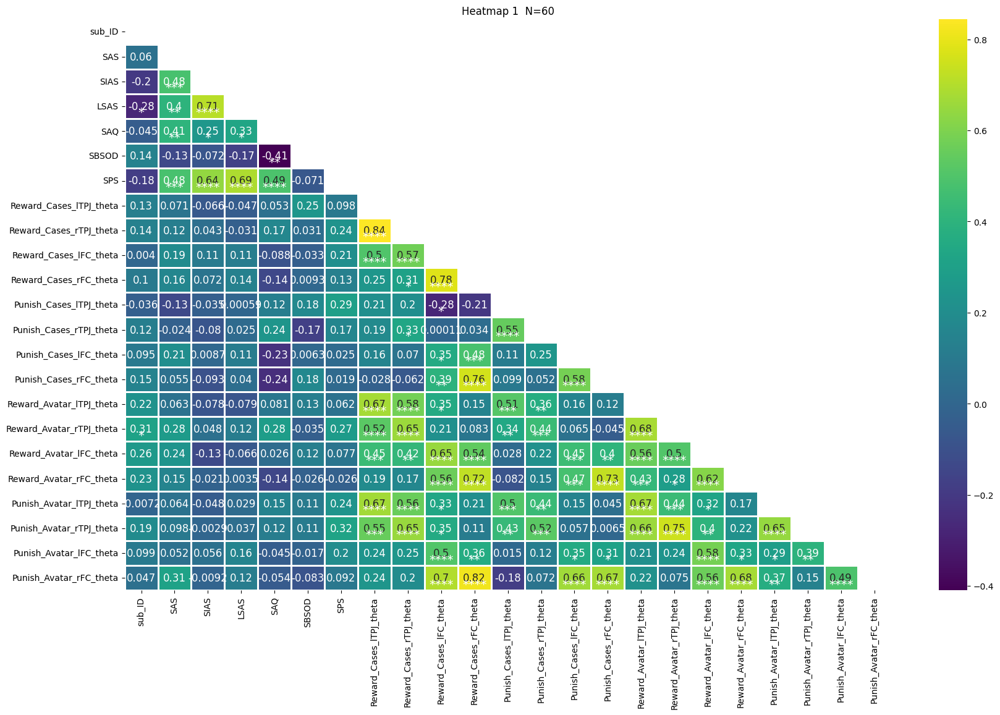

In [8]:
c = generate_corrmap(behdata, approach_bandata,quizlist, approach_thetaband_list, location='plot_test/test_approach_ques_theta')

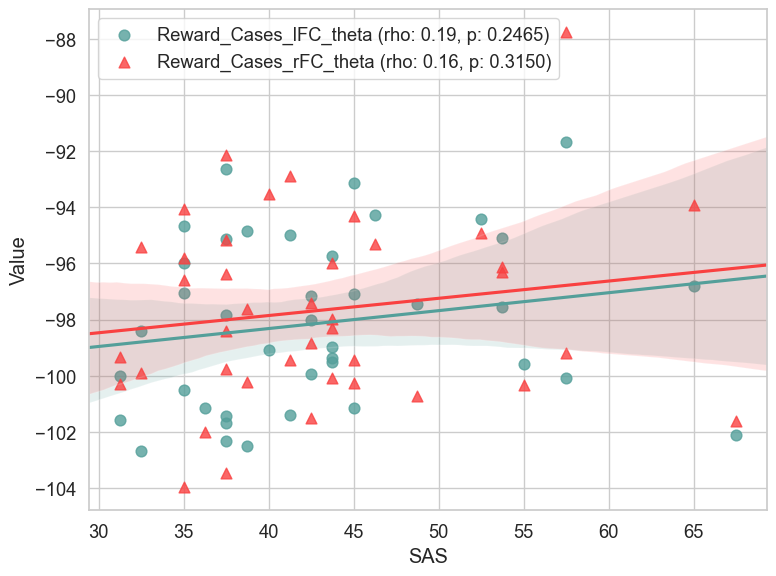

<Figure size 640x480 with 0 Axes>

In [9]:
plot_reg_single_y('SAS','Reward_Cases_lFC_theta','Reward_Cases_rFC_theta', c, save=False)

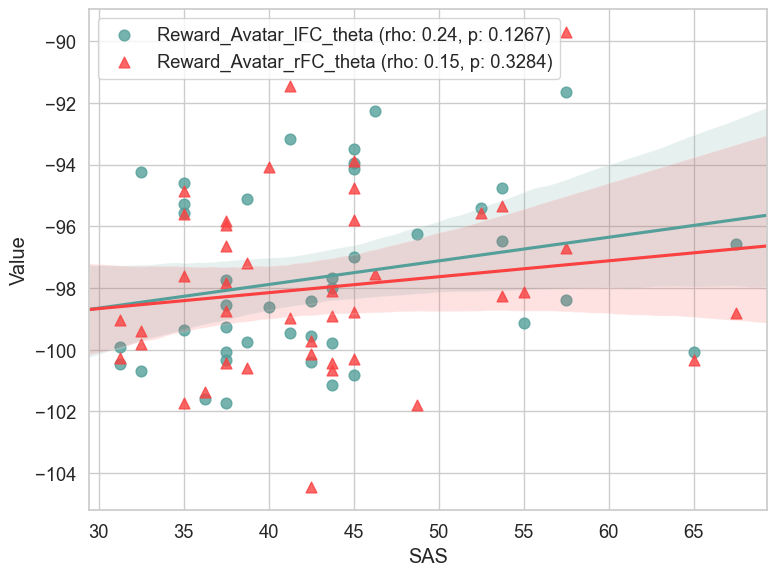

<Figure size 640x480 with 0 Axes>

In [10]:
plot_reg_single_y('SAS','Reward_Avatar_lFC_theta','Reward_Avatar_rFC_theta', c, save=False)

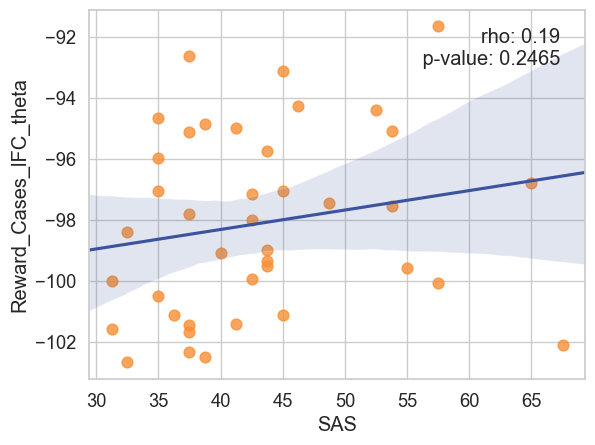

<Figure size 640x480 with 0 Axes>

In [11]:
plot_reg('SAS','Reward_Cases_lFC_theta',c,row=0,col=0,ind=0,save =False)

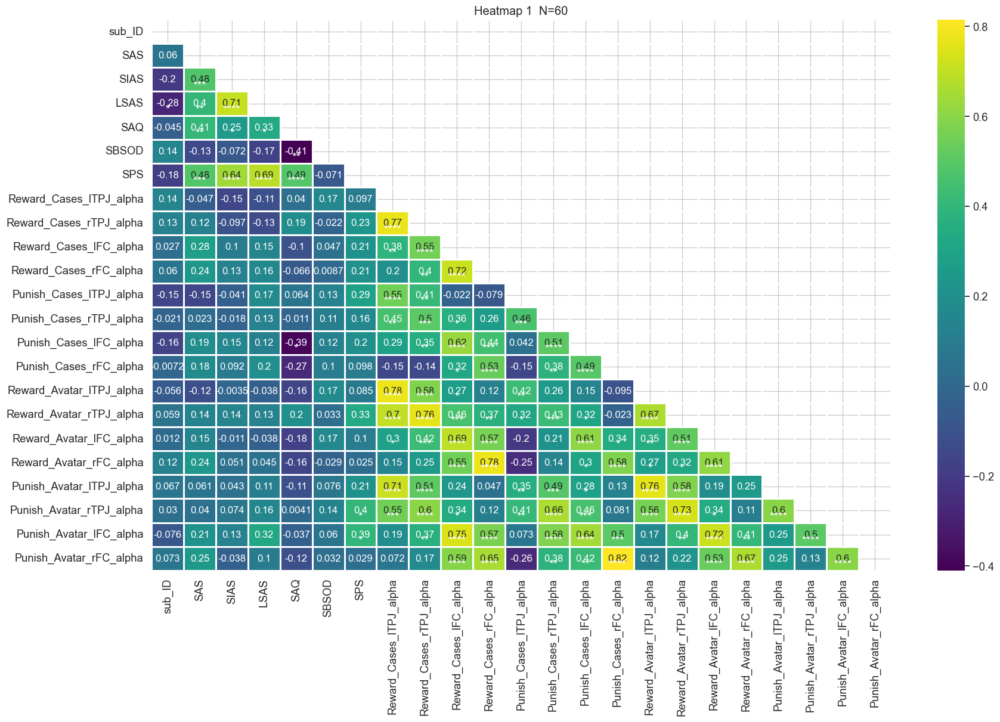

In [12]:
c = generate_corrmap(behdata, approach_bandata,quizlist, approach_alphaband_list, location='plot_test/test_approach_ques_alpha')

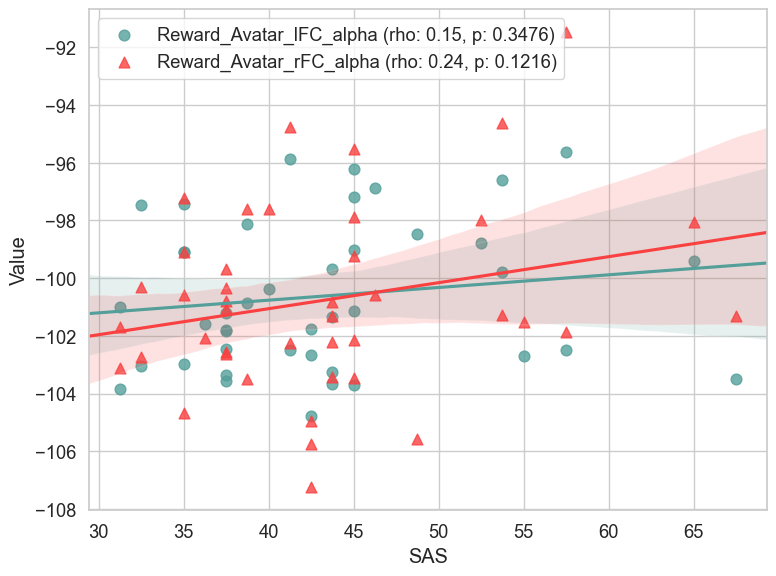

<Figure size 640x480 with 0 Axes>

In [13]:
plot_reg_single_y('SAS','Reward_Avatar_lFC_alpha','Reward_Avatar_rFC_alpha', c, save=False)

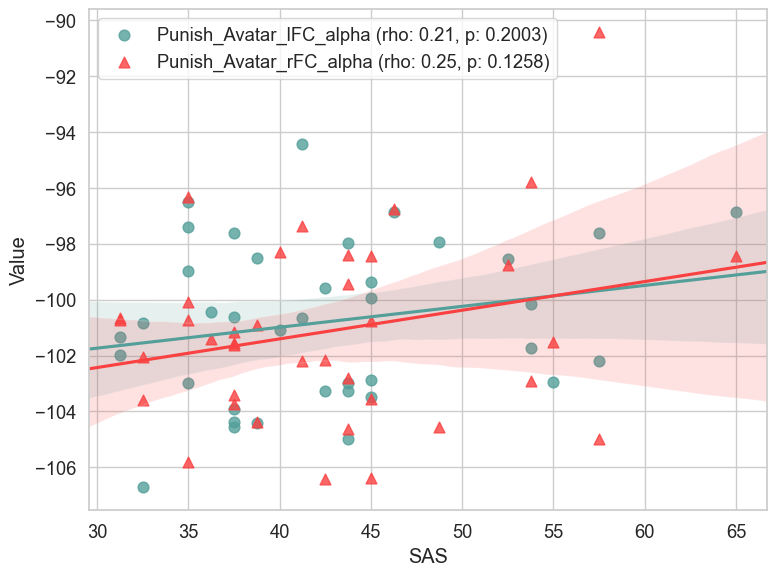

<Figure size 640x480 with 0 Axes>

In [14]:
plot_reg_single_y('SAS','Punish_Avatar_lFC_alpha','Punish_Avatar_rFC_alpha', c, save=False)

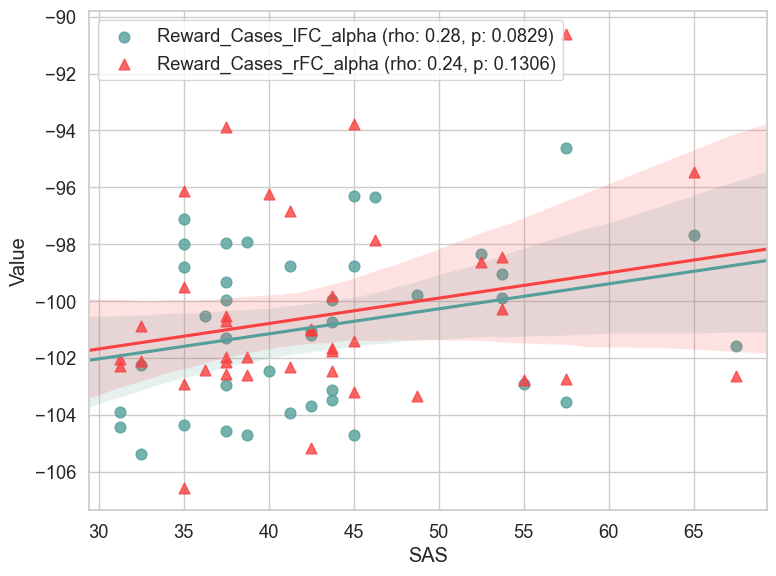

<Figure size 640x480 with 0 Axes>

In [15]:
plot_reg_single_y('SAS','Reward_Cases_lFC_alpha','Reward_Cases_rFC_alpha', c, save=False)

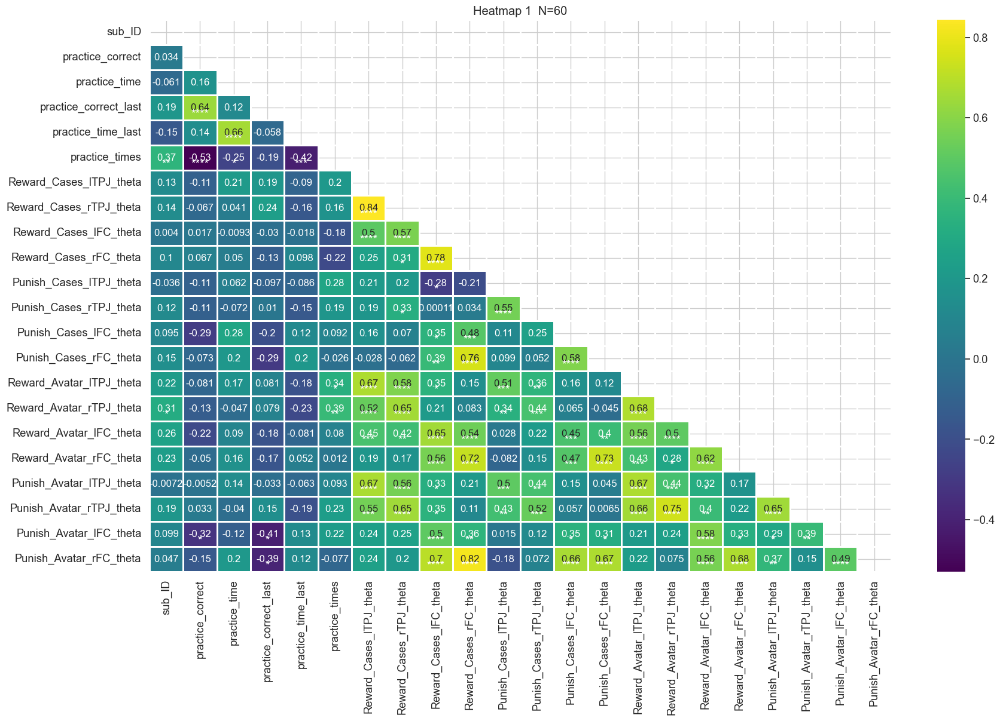

In [16]:
# c = generate_corrmap(behdata, asydata_cropped, nav_prac,asydatalist, location='plot_rest/rest_asy_prac')

c = generate_corrmap(behdata, approach_bandata, nav_prac,approach_thetaband_list, location='plot_test/test_approach_prac_theta')

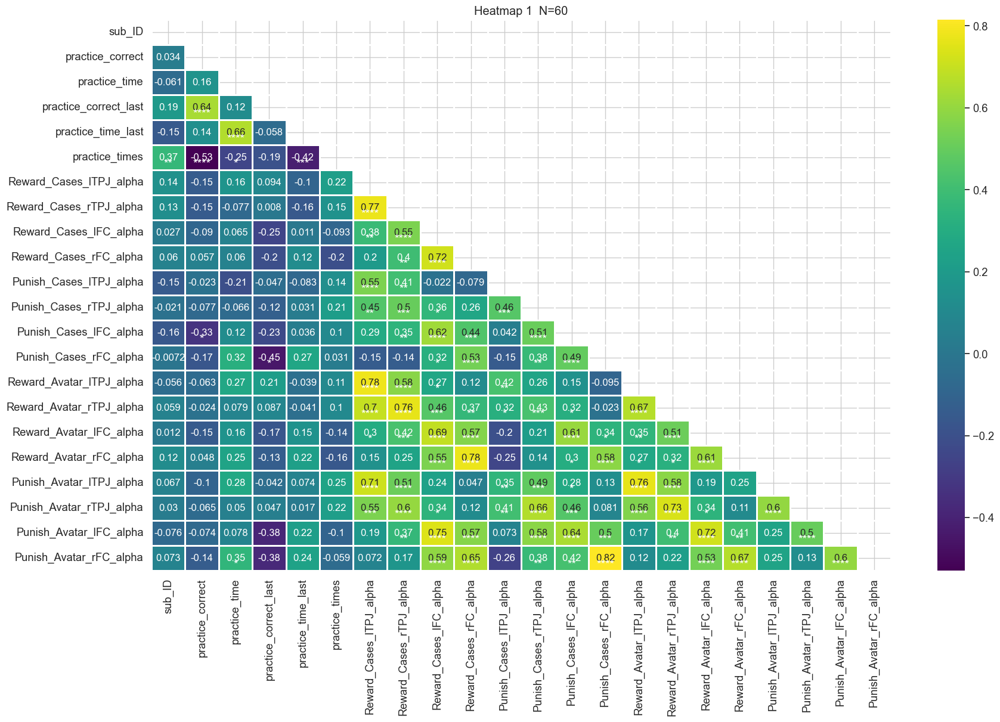

In [17]:
c = generate_corrmap(behdata, approach_bandata, nav_prac,approach_alphaband_list, location='plot_test/test_approach_prac_alpha')

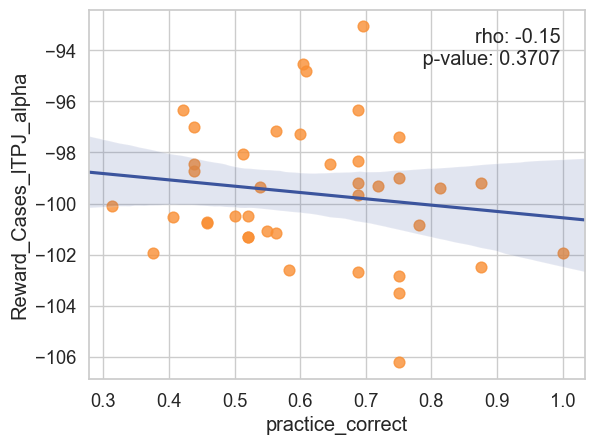

<Figure size 640x480 with 0 Axes>

In [18]:
plot_reg('practice_correct','Reward_Cases_lTPJ_alpha',c,row=0,col=0,ind=0,save =False)

3. task power data and nav (speed / distance / pausetime)

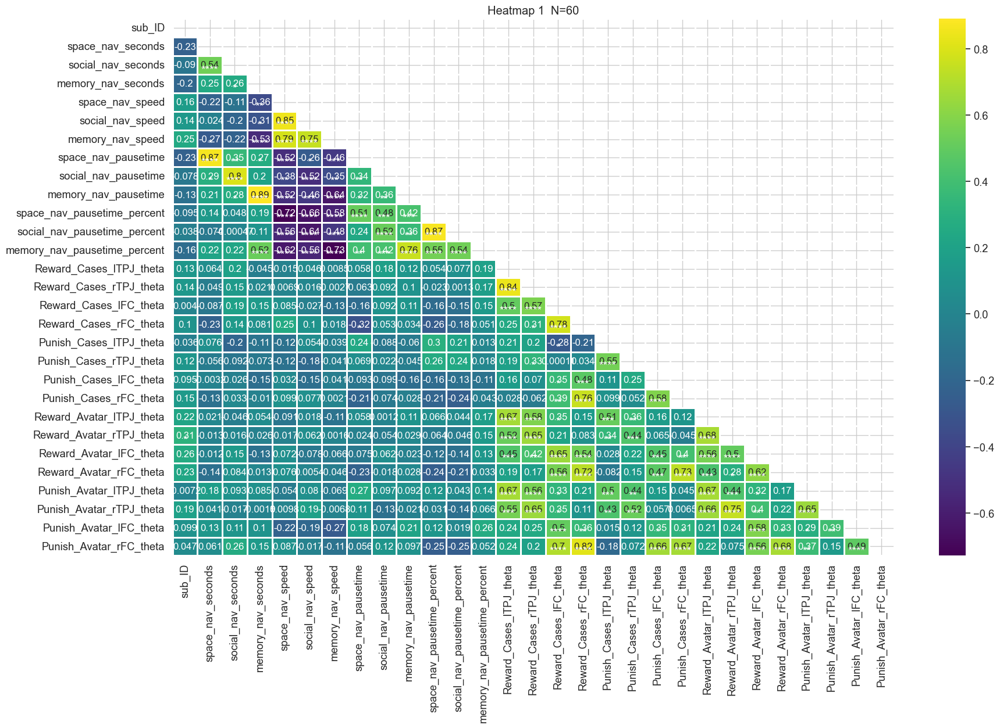

In [19]:
nav_no_distance = [ i for i in nav_no_block if 'distance' not in i]
c = generate_corrmap(behdata, approach_bandata,nav_no_distance ,approach_thetaband_list, location='plot_test/test_approach_nav_theta')

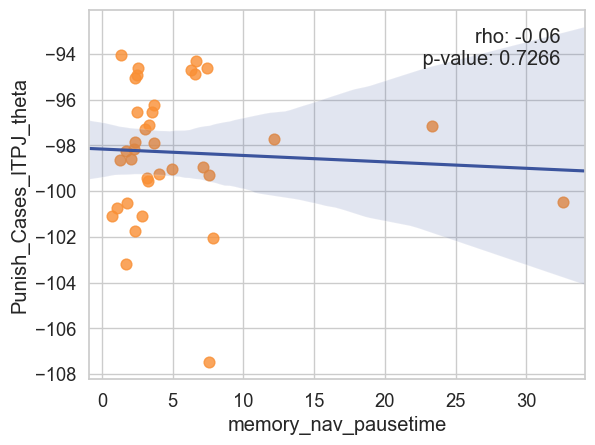

<Figure size 640x480 with 0 Axes>

In [20]:
plot_reg('memory_nav_pausetime','Punish_Cases_lTPJ_theta',c,row=0,col=0,ind=0,save =False)

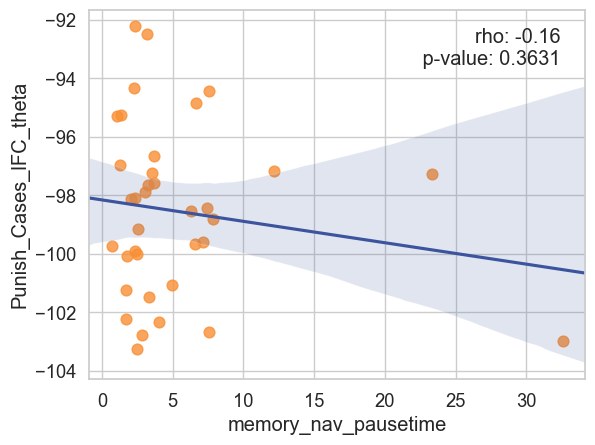

<Figure size 640x480 with 0 Axes>

In [21]:
plot_reg('memory_nav_pausetime','Punish_Cases_lFC_theta',c,row=0,col=0,ind=0,save =False)

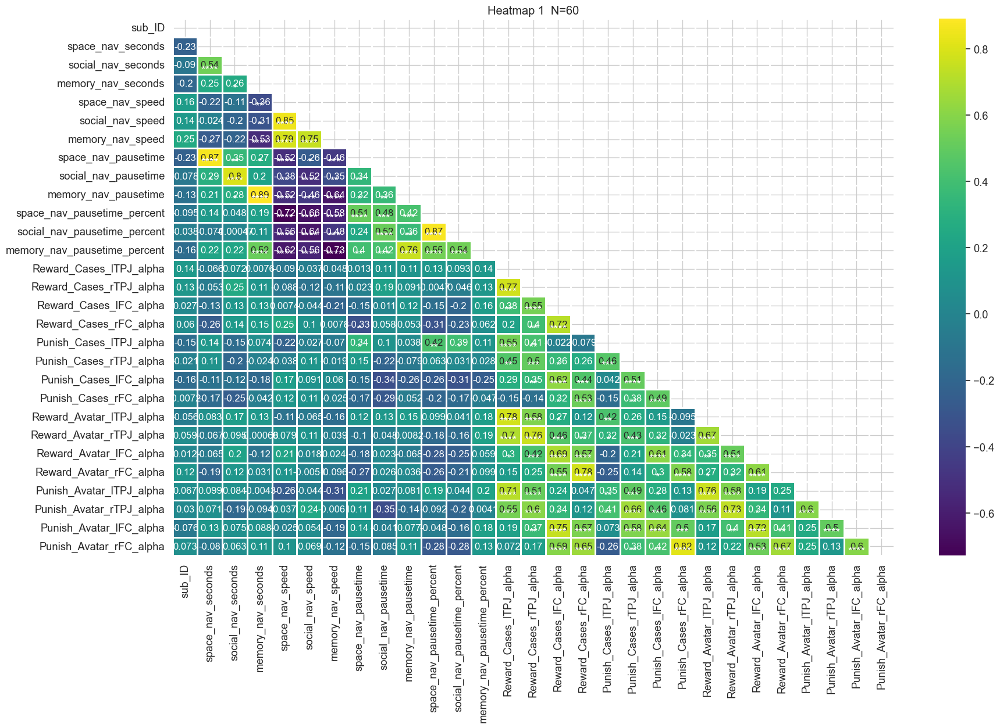

In [22]:
nav_no_distance = [ i for i in nav_no_block if 'distance' not in i]

c = generate_corrmap(behdata, approach_bandata,nav_no_distance ,approach_alphaband_list, location='plot_test/test_approach_nav_alpha')

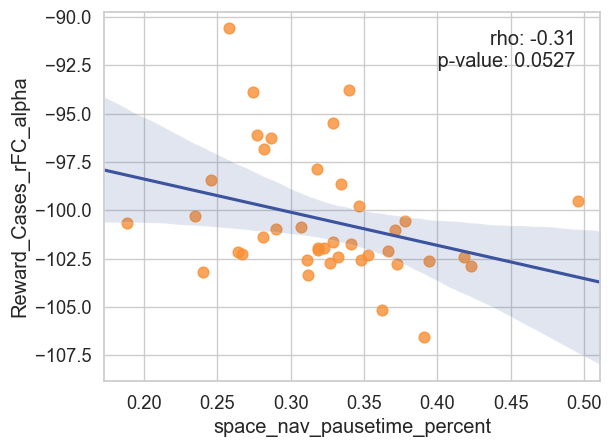

<Figure size 640x480 with 0 Axes>

In [23]:
plot_reg('space_nav_pausetime_percent','Reward_Cases_rFC_alpha',c,row=0,col=0,ind=0,save =False)

3.2. test approach power data and nav (Approach/ approach)

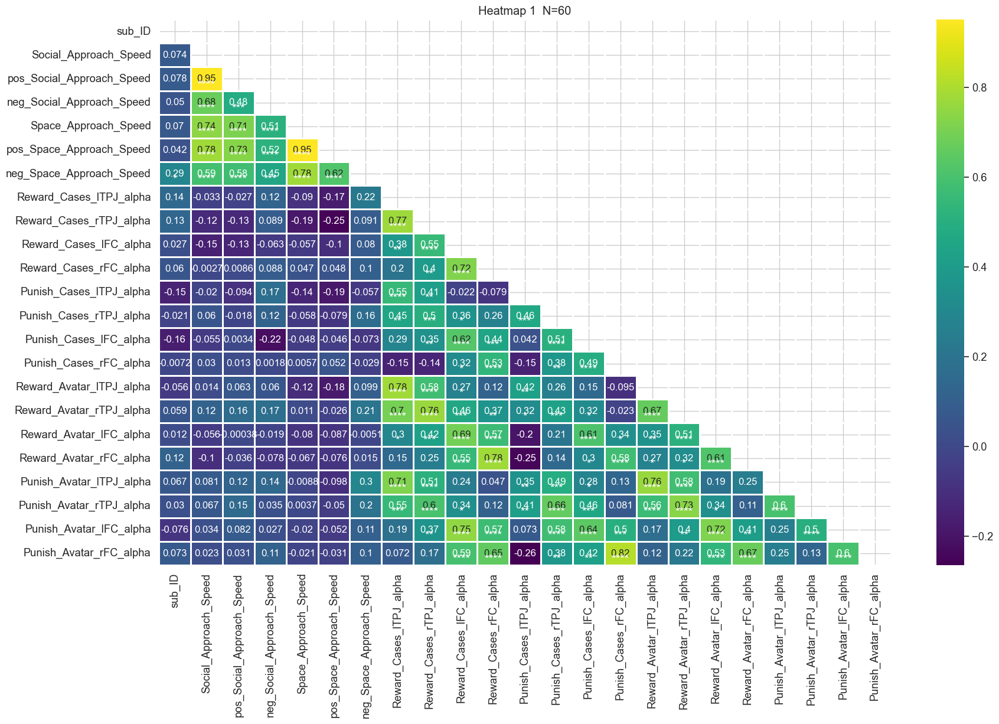

In [24]:
nav_noblock_app_speed = [i for i in nav_app_speed if 'block' not in i]

c = generate_corrmap(behdata, approach_bandata, nav_noblock_app_speed,approach_alphaband_list, location='plot_test/test_approach_app_alpha')

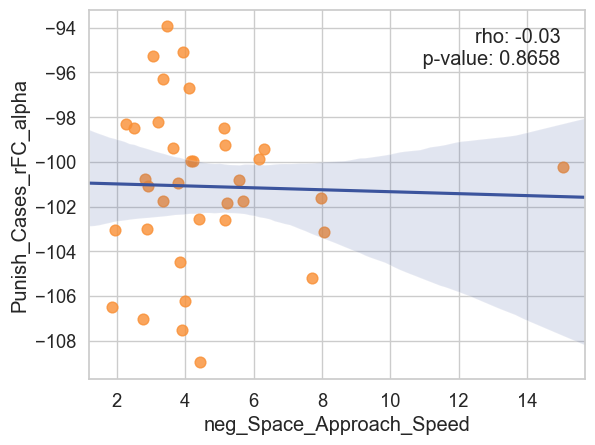

<Figure size 640x480 with 0 Axes>

In [25]:
plot_reg('neg_Space_Approach_Speed','Punish_Cases_rFC_alpha',c,row=0,col=0,ind=0,save =False)

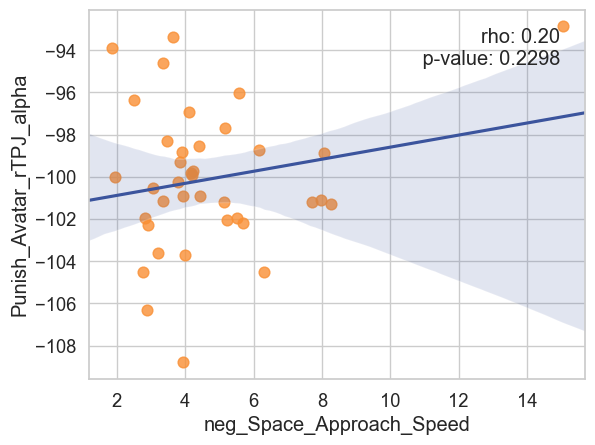

<Figure size 640x480 with 0 Axes>

In [26]:
plot_reg('neg_Space_Approach_Speed','Punish_Avatar_rTPJ_alpha',c,row=0,col=0,ind=0,save =False)

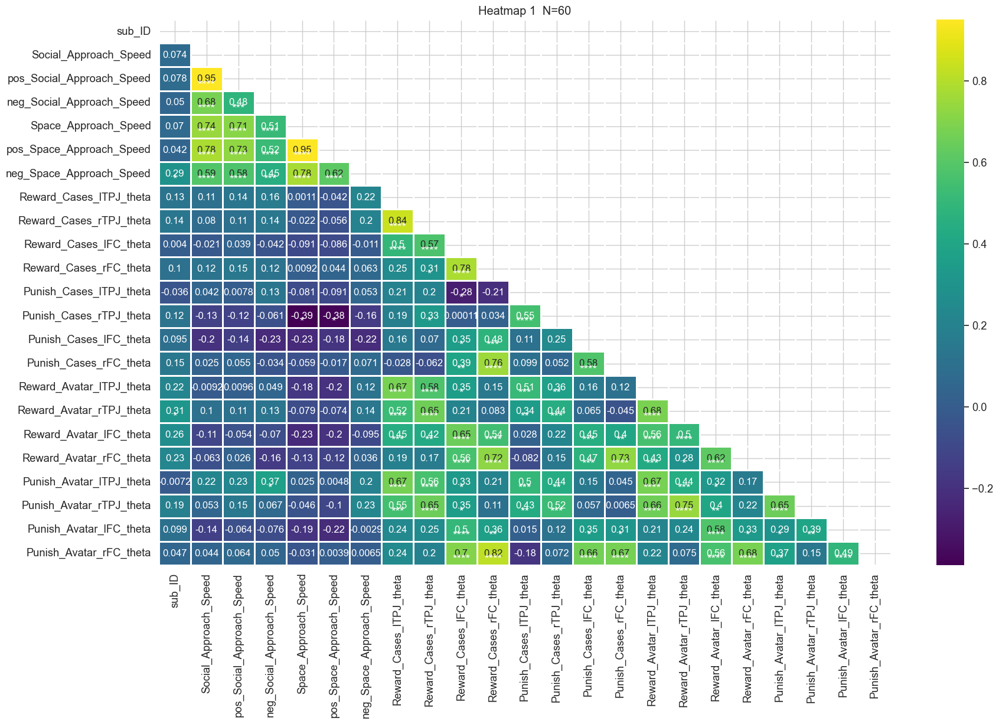

In [27]:
c = generate_corrmap(behdata, approach_bandata, nav_noblock_app_speed,approach_thetaband_list, location='plot_test/test_approach_app_theta')

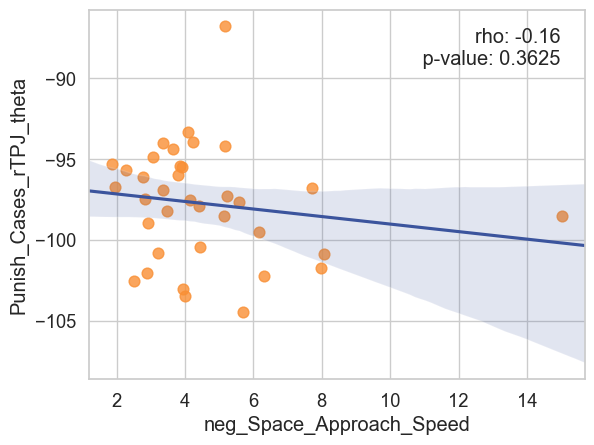

<Figure size 640x480 with 0 Axes>

In [28]:
# plot_reg_single_y('Punish_Avatar_lTPJ_theta','neg_Social_Approach_Speed','neg_Space_Approach_Speed', c, save=False)
plot_reg('neg_Space_Approach_Speed','Punish_Cases_rTPJ_theta',c,row=0,col=0,ind=0,save =False)

In [29]:
plot_reg('Punish_Avatar_rTPJ_alpha','pos_Social_Approach_Speed',c,row=0,col=0,ind=0,save =False)

KeyError: ['Punish_Avatar_rTPJ_alpha']

In [ ]:
nav_leave_speed2 = [i for i in nav_leave_speed if 'block' not in i]
c = generate_corrmap(behdata, approach_bandata, nav_leave_speed2,approach_alphaband_list, location='plot_test/test_approach_approachach_alpha')

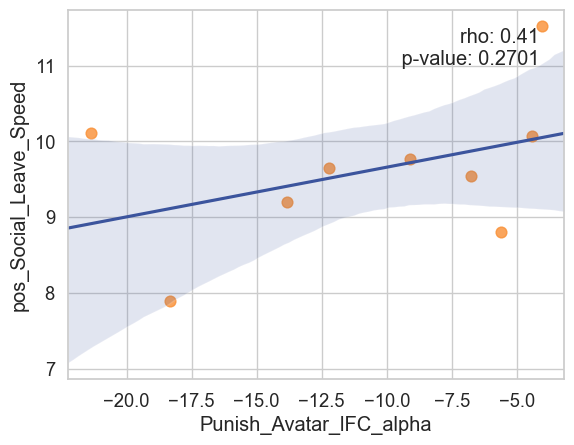

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('Punish_Avatar_lFC_alpha','pos_Social_approachach_Speed',c,row=0,col=0,ind=0,save =False)

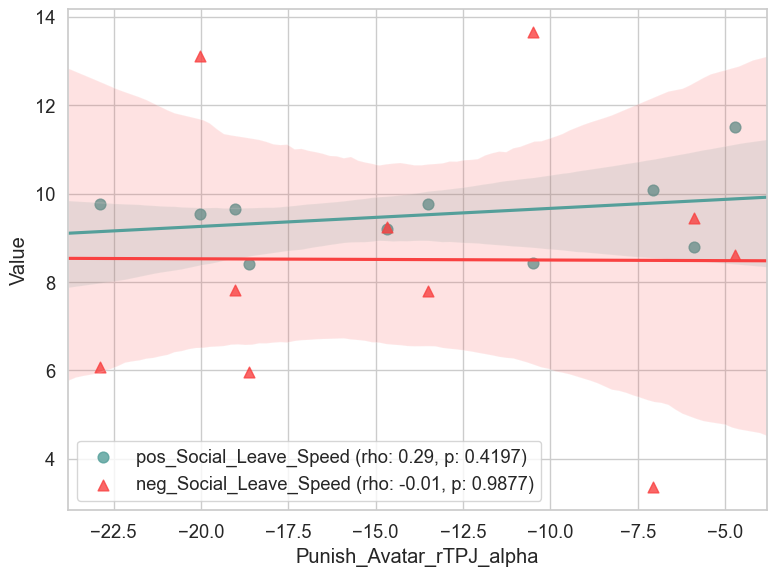

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg_single_y('Punish_Avatar_rTPJ_alpha','pos_Social_approach_Speed','neg_Social_approach_Speed', c, save=False)

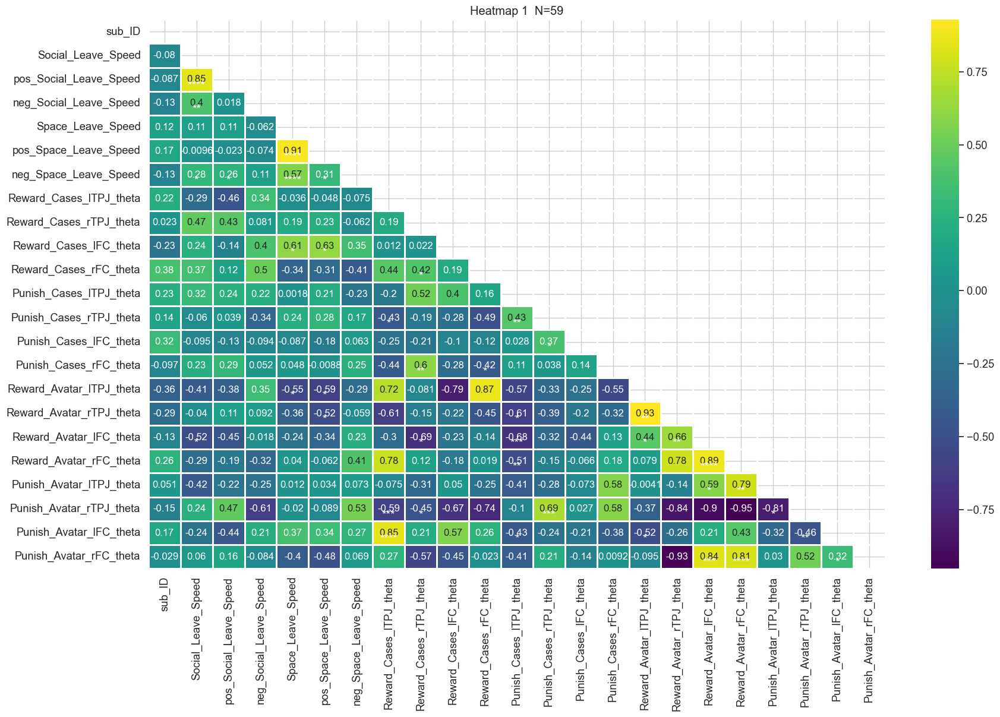

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_leave_speed2,approach_thetaband_list, location='plot_test/test_approach_approach_theta')

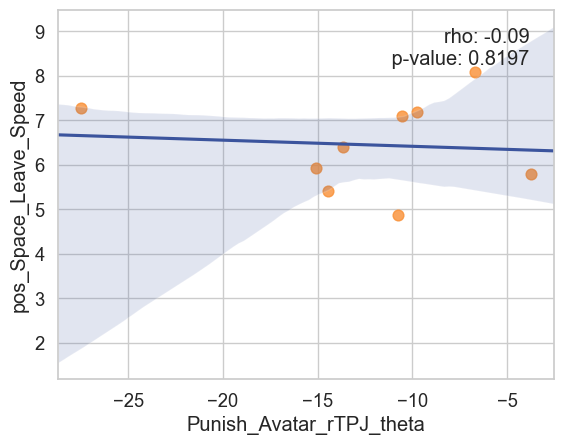

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('Punish_Avatar_rTPJ_theta','pos_Space_approach_Speed',c,row=0,col=0,ind=0,save =False)

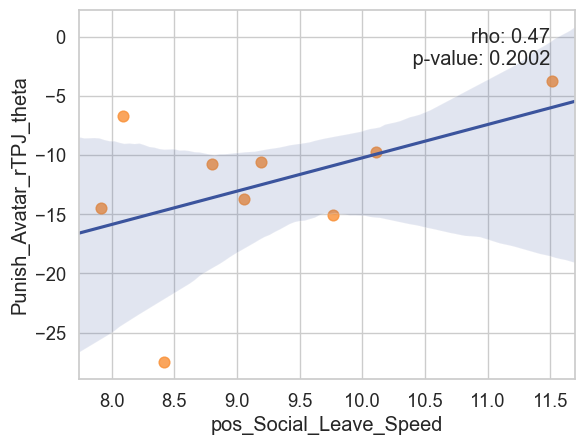

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('pos_Social_approach_Speed','Punish_Avatar_rTPJ_theta',c,row=0,col=0,ind=0,save =False)

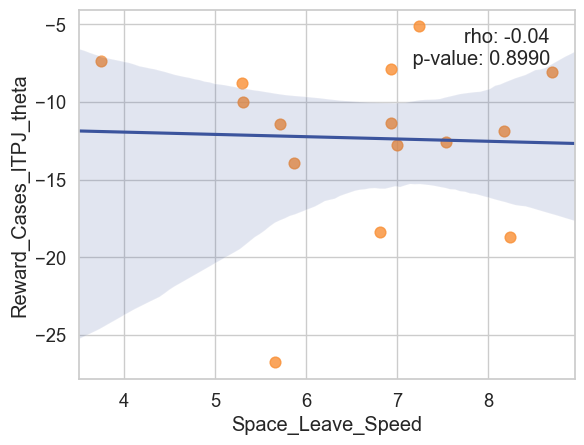

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('Space_approach_Speed','Reward_Cases_lTPJ_theta',c,row=0,col=0,ind=0,save =False)

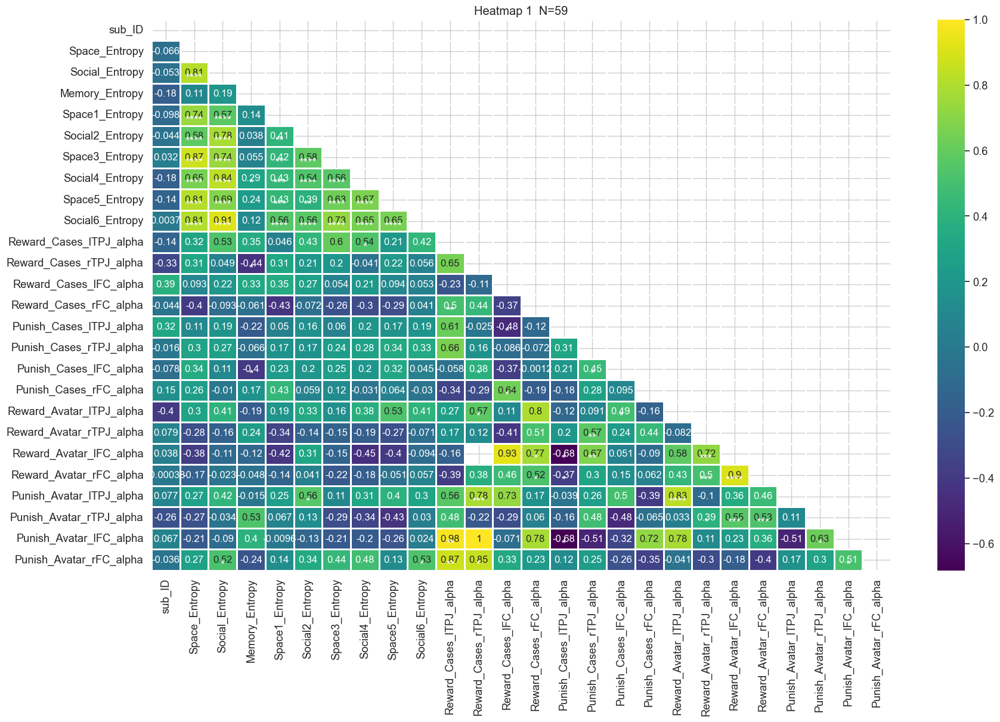

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_entropy,approach_alphaband_list, location='plot_test/test_approach_entropy_alpha')

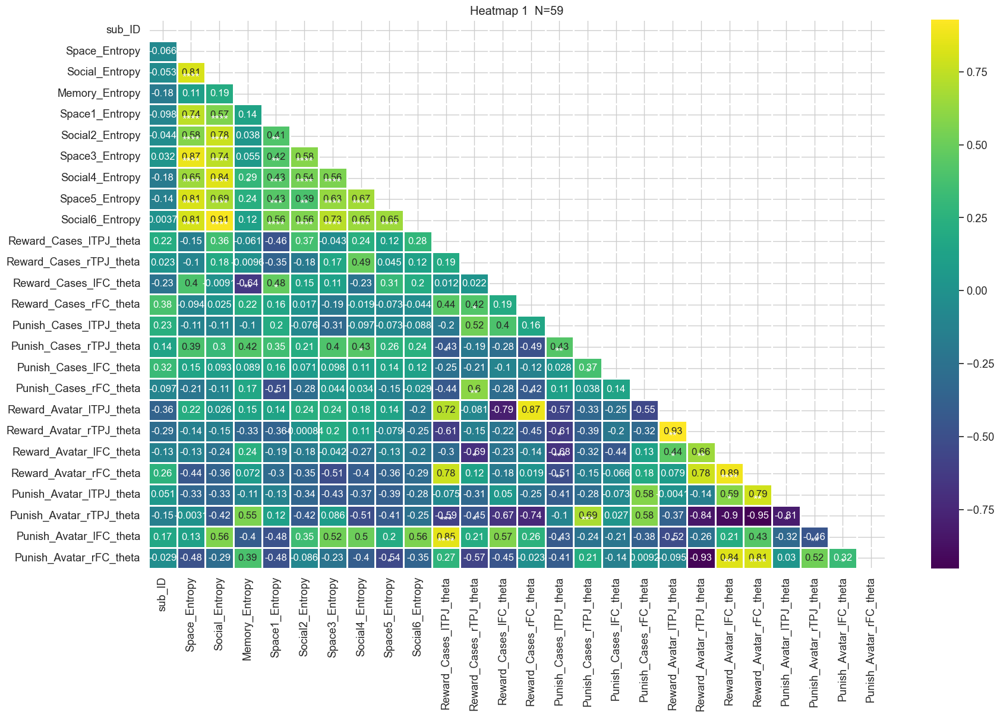

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_entropy,approach_thetaband_list, location='plot_test/test_approach_entropy_theta')

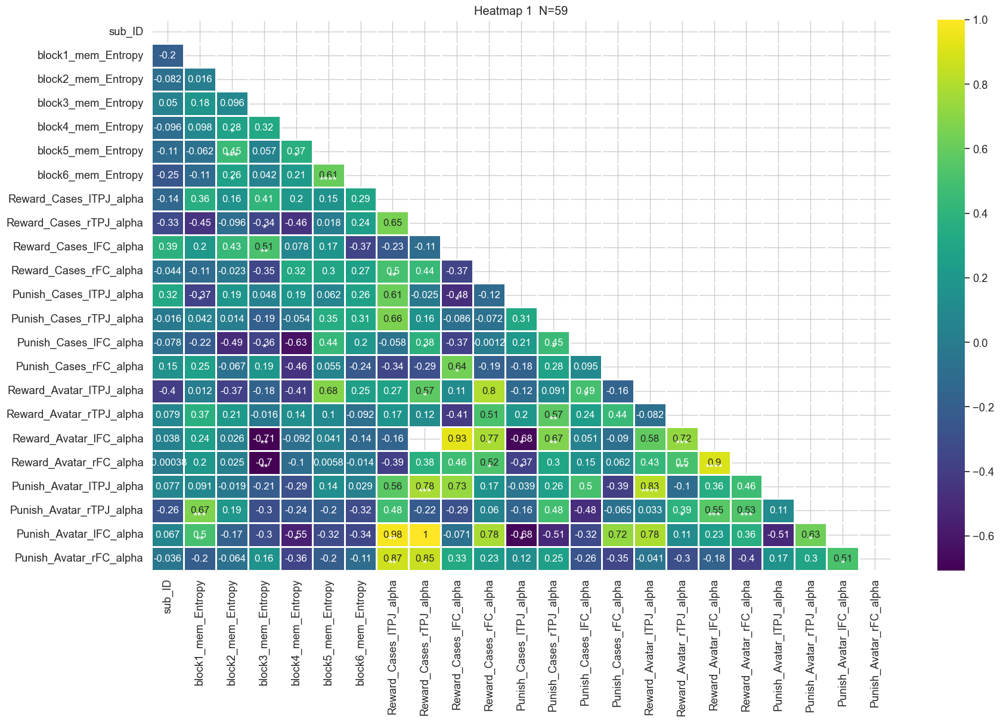

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_entropy_mem_change,approach_alphaband_list, location='plot_test/test_approach_entropy_mem_alpha')

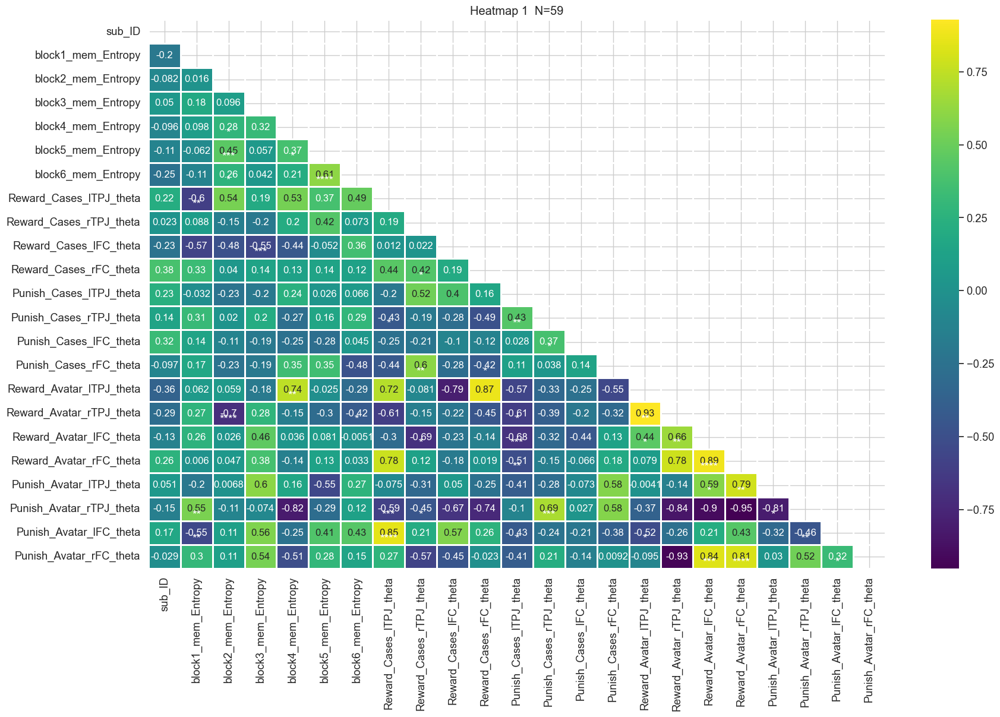

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_entropy_mem_change,approach_thetaband_list, location='plot_test/test_approach_entropy_mem_theta')

4. test approach power data  and nav (reward)

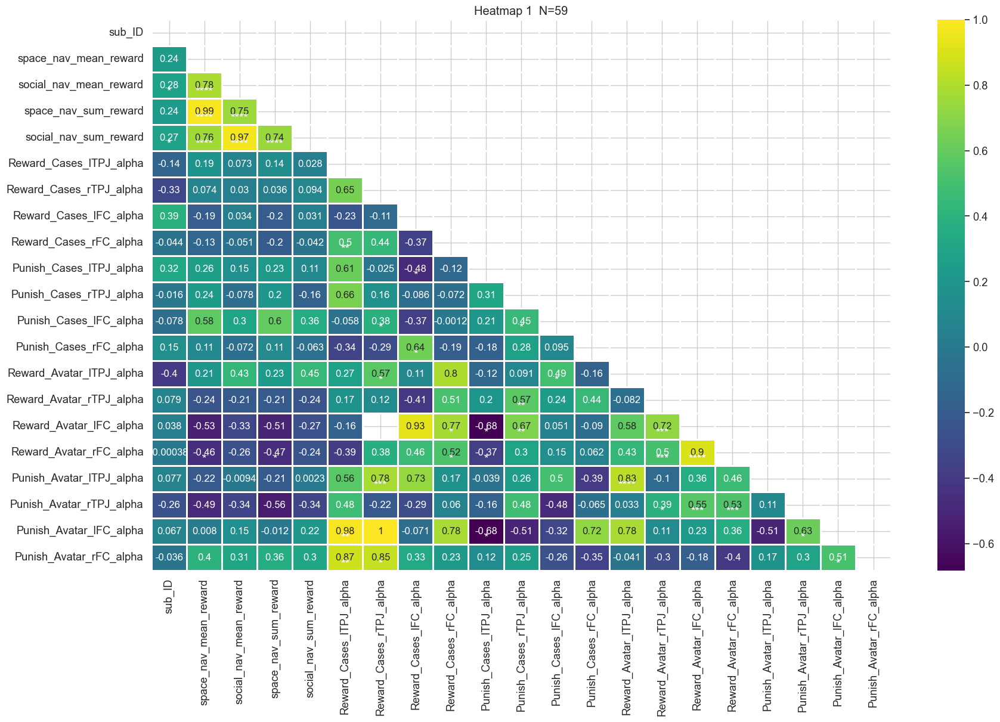

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_reward,approach_alphaband_list, location='plot_test/test_approach_reward_alpha')

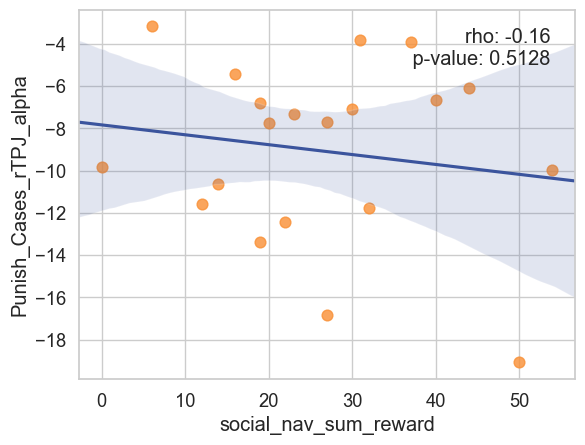

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('social_nav_sum_reward','Punish_Cases_rTPJ_alpha',c,row=0,col=0,ind=0,save =False)

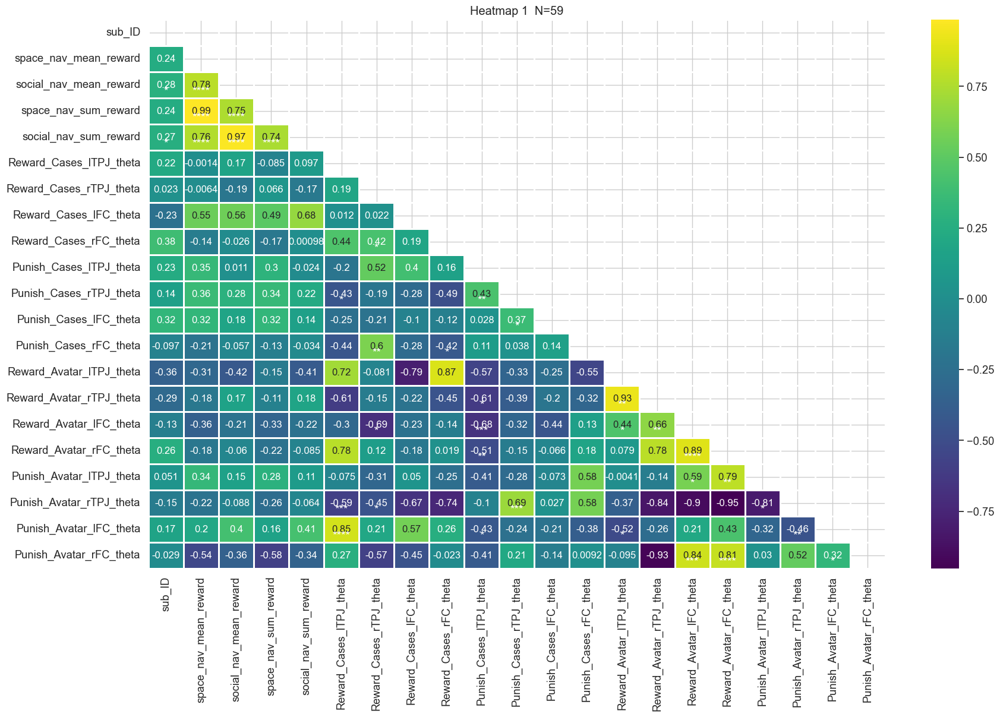

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_reward,approach_thetaband_list, location='plot_test/test_approach_reward_theta')

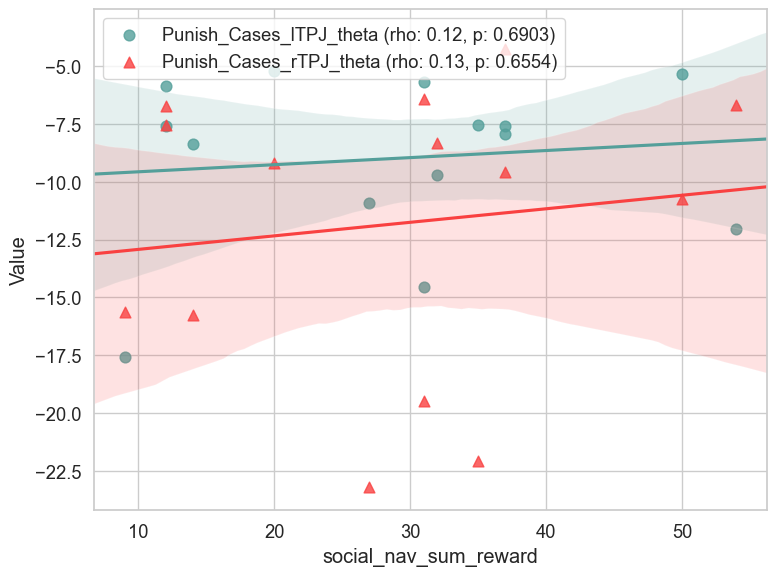

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg_single_y('social_nav_sum_reward','Punish_Cases_lTPJ_theta','Punish_Cases_rTPJ_theta', c, save=False)

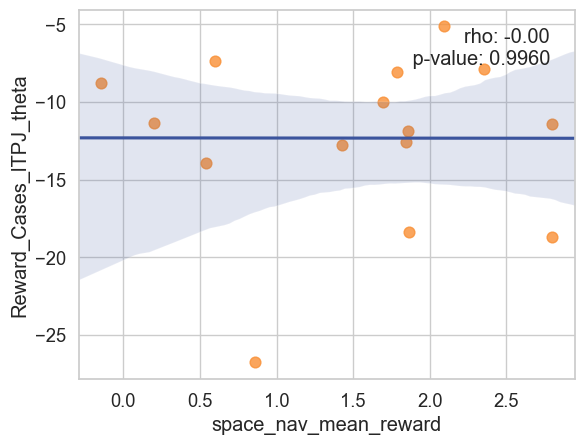

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('space_nav_mean_reward','Reward_Cases_lTPJ_theta',c,row=0,col=0,ind=0,save =False)

5. test approach power data  and nav_rate (willingness/anxiety)

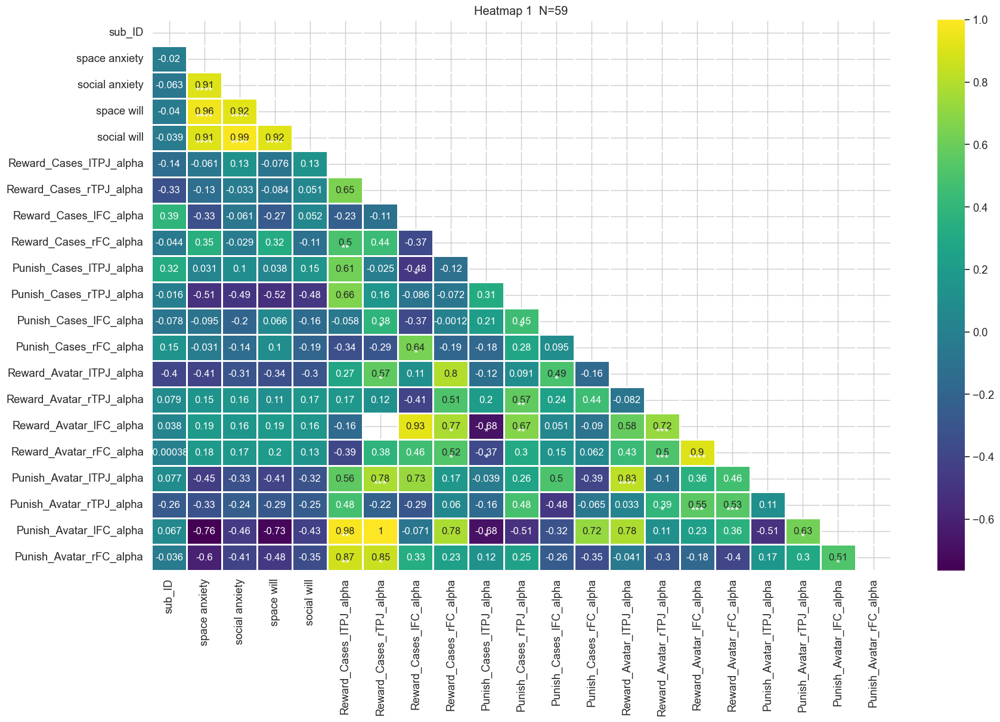

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_rate,approach_alphaband_list, location='plot_test/test_approach_rate_alpha')

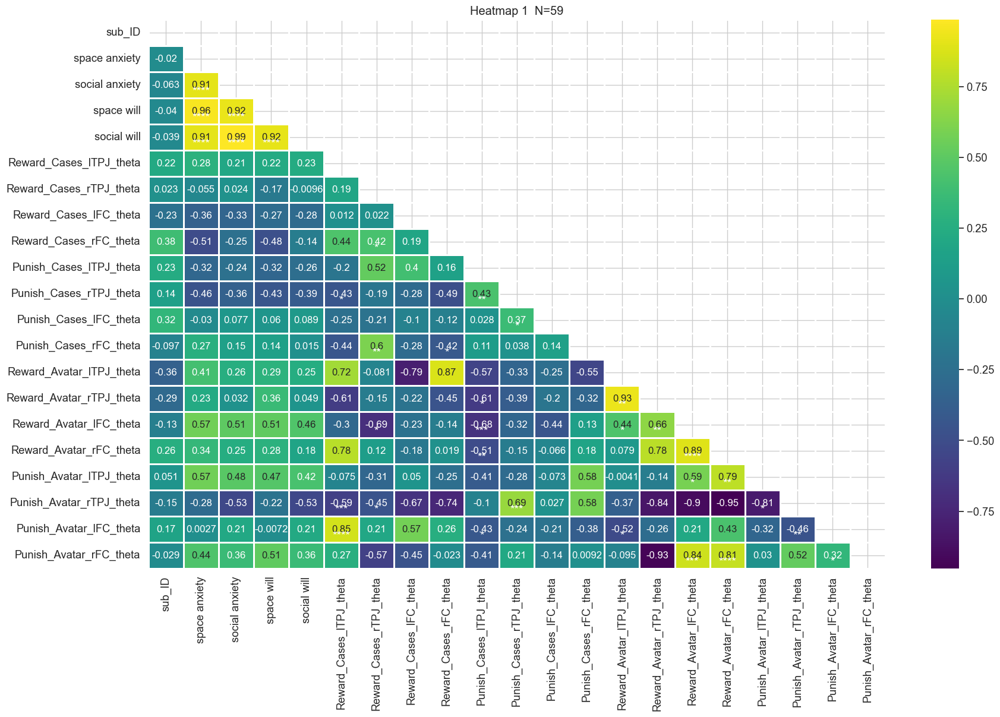

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_rate,approach_thetaband_list, location='plot_test/test_approach_rate_theta')

6. test power data and nav_mem ( corr/rts for recognition task)

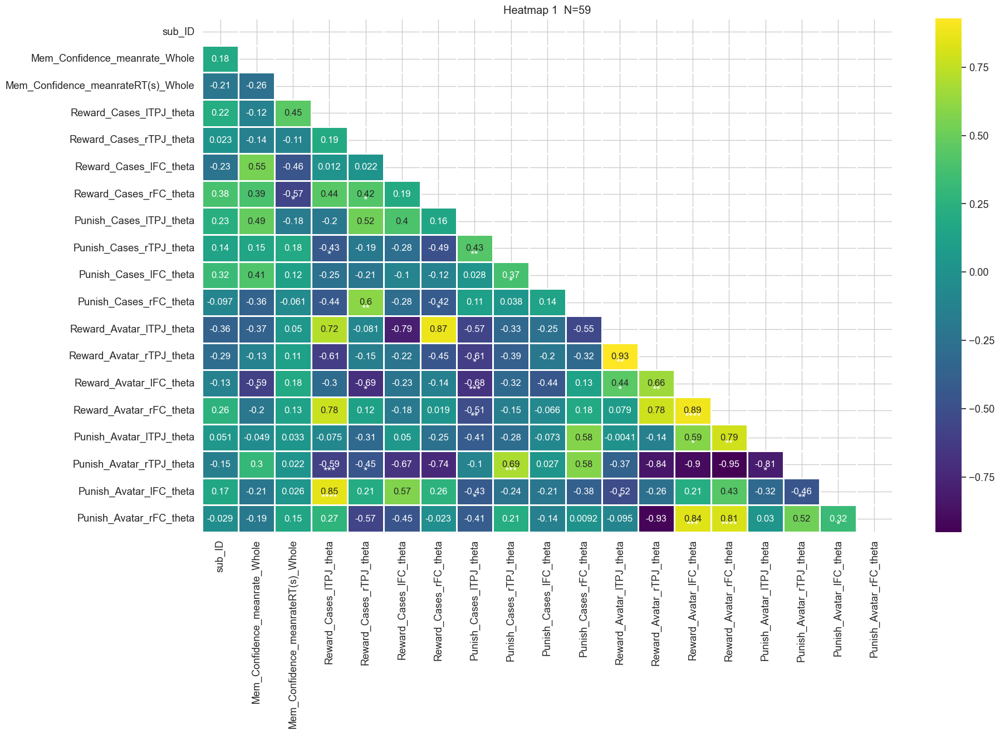

In [ ]:
nav_conf_whole = ['sub_ID']+ [i for i in nav_conf if 'Whole' in i]

c = generate_corrmap(behdata, approach_bandata, nav_conf_whole ,approach_thetaband_list, location='plot_test/test_approach_confidence_theta')
# c = generate_corrmap(behdata, approach_bandata, nav_rate,approach_thetaband_list, location='plot_test/test_approach_rate_theta')

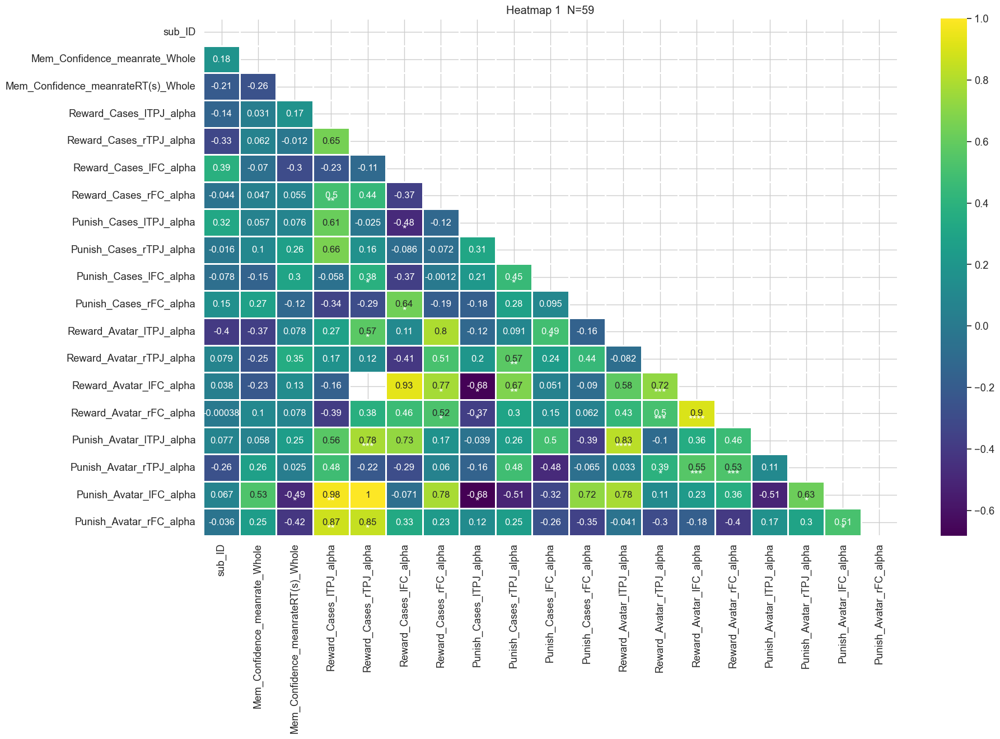

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_conf_whole ,approach_alphaband_list, location='plot_test/test_approach_confidence_alpha')


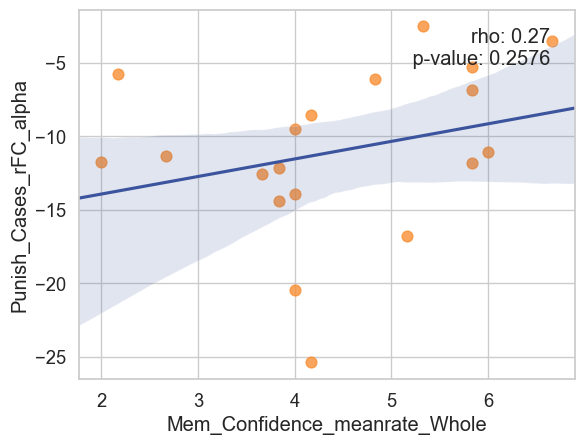

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('Mem_Confidence_meanrate_Whole','Punish_Cases_rFC_alpha',c,row=0,col=0,ind=0,save =False)

7. test power data and nav_mem ( corr/rts for recognition task)

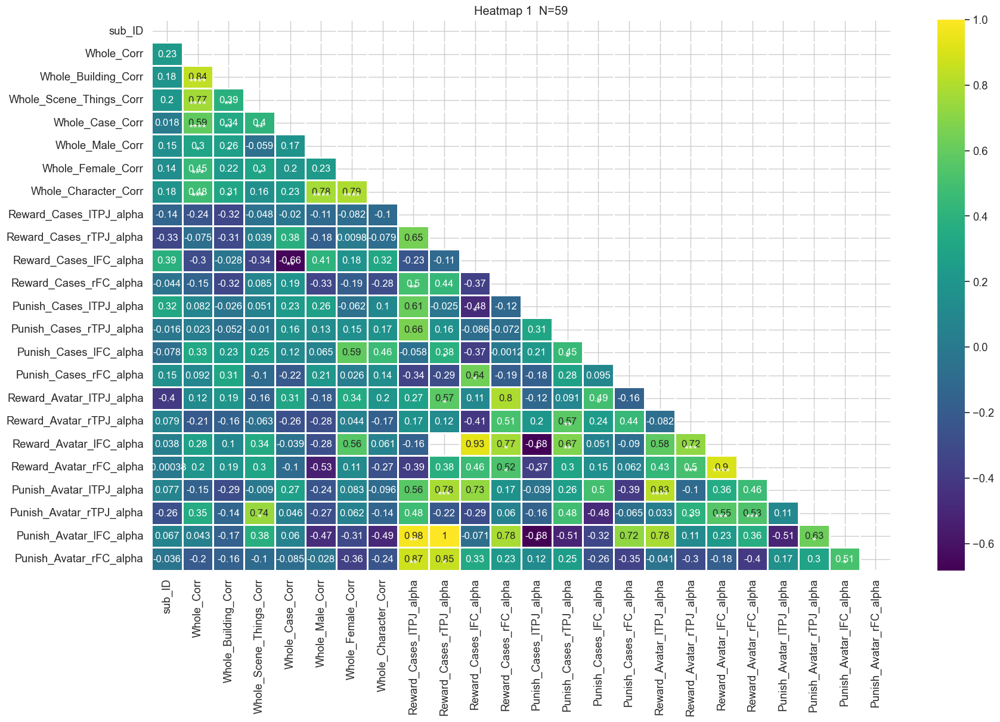

In [ ]:
nav_mem_whole_corr = ['sub_ID'] + [i for i in nav_mem_whole if 'Corr' in i and 'CorrT' not in i and 'CorrF' not in i]

nav_mem_whole_RT = ['sub_ID'] + [i for i in nav_mem_whole if 'RT' in i and 'RTT' not in i and 'RTF' not in i]

c = generate_corrmap(behdata, approach_bandata, nav_mem_whole_corr ,approach_alphaband_list, location='plot_test/test_approach_mem_alpha')
# c = generate_corrmap(behdata, approach_bandata, nav_conf_whole ,approach_alphaband_list, location='plot_rest/rest_asy_confidence_alpha')

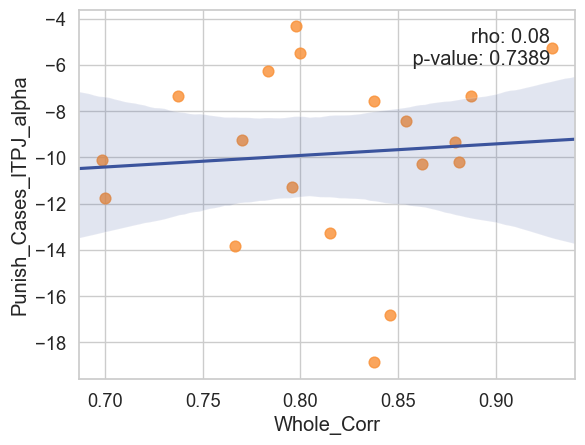

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('Whole_Corr','Punish_Cases_lTPJ_alpha',c,row=0,col=0,ind=0,save =False)

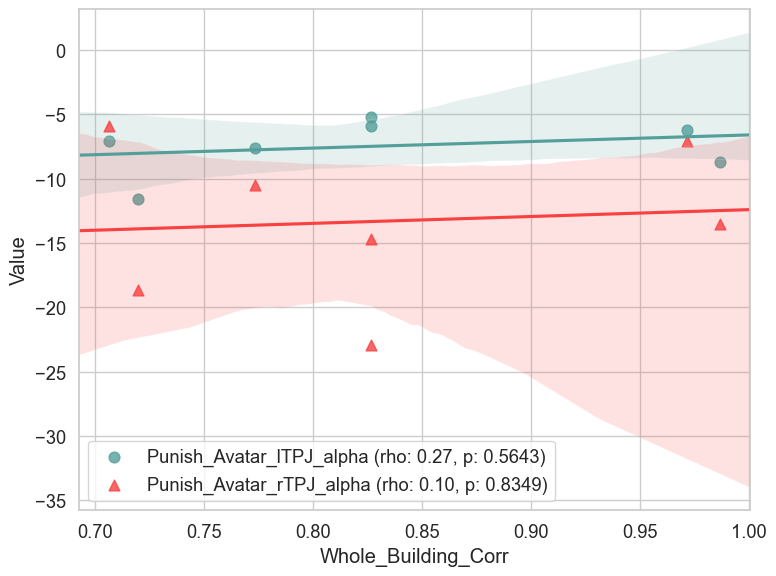

<Figure size 640x480 with 0 Axes>

In [ ]:
# plot_reg('Whole_Building_Corr','Punish_Avatar_rTPJ_alpha',c,row=0,col=0,ind=0,save =False)

plot_reg_single_y('Whole_Building_Corr','Punish_Avatar_lTPJ_alpha','Punish_Avatar_rTPJ_alpha', c, save=False)

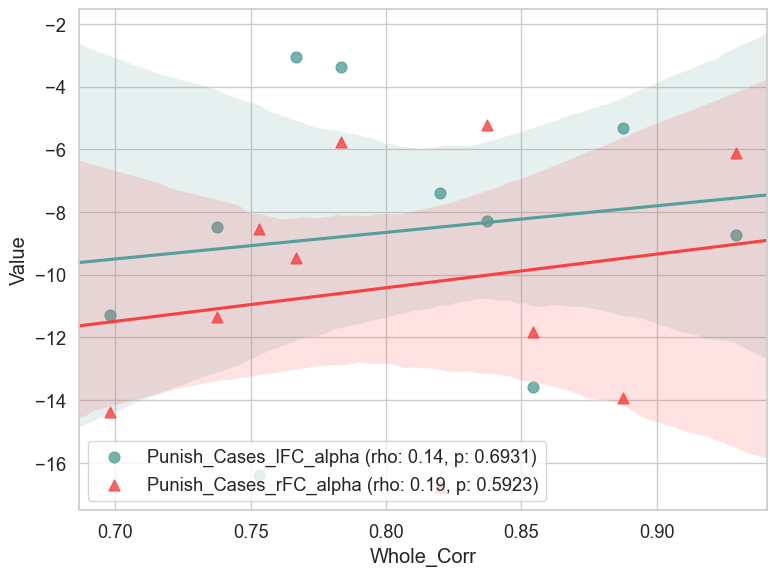

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg_single_y('Whole_Corr','Punish_Cases_lFC_alpha','Punish_Cases_rFC_alpha', c, save=False)

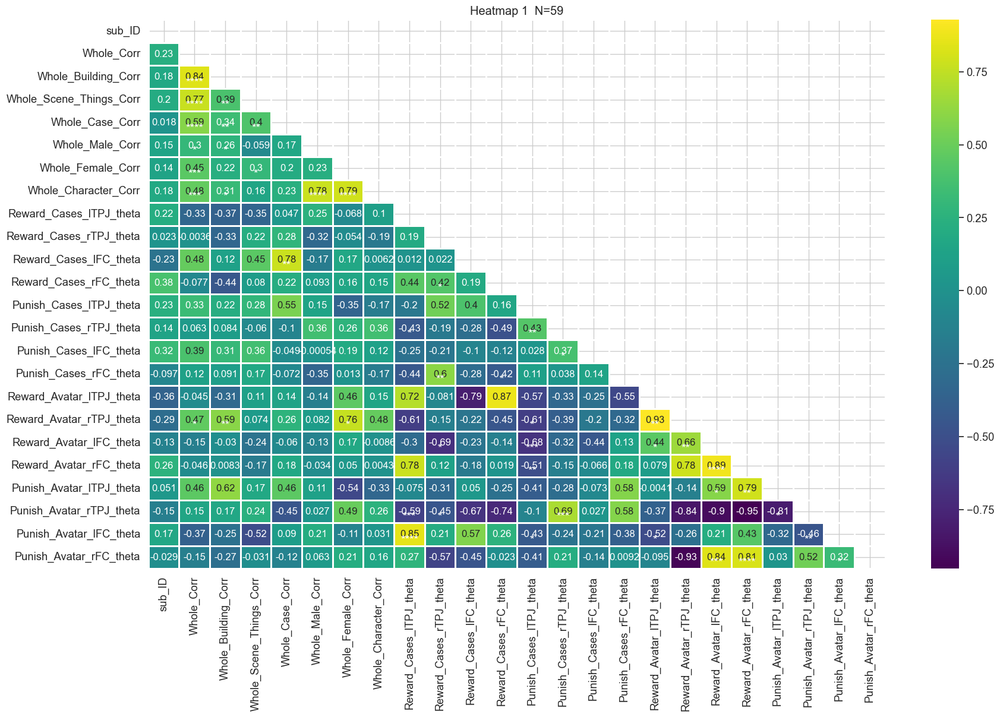

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_mem_whole_corr ,approach_thetaband_list, location='plot_test/test_approach_mem_theta')

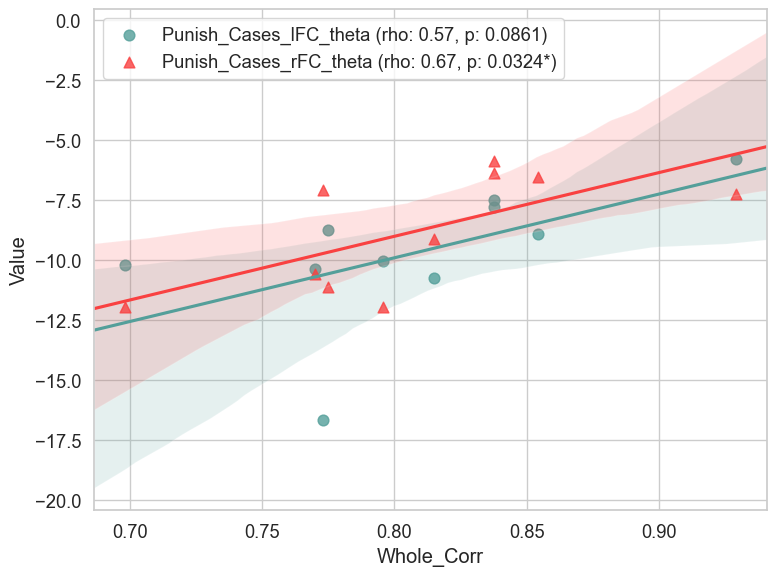

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg_single_y('Whole_Corr','Punish_Cases_lFC_theta','Punish_Cases_rFC_theta', c, save=False)

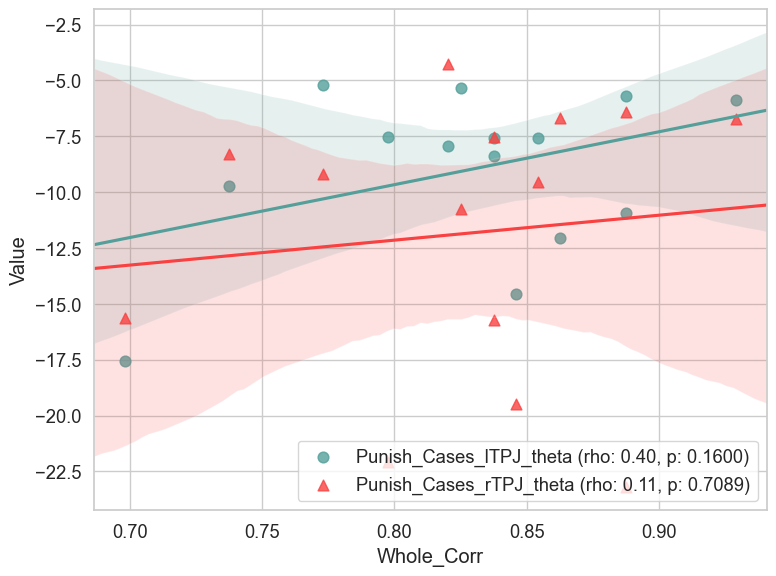

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg_single_y('Whole_Corr','Punish_Cases_lTPJ_theta','Punish_Cases_rTPJ_theta', c, save=False)

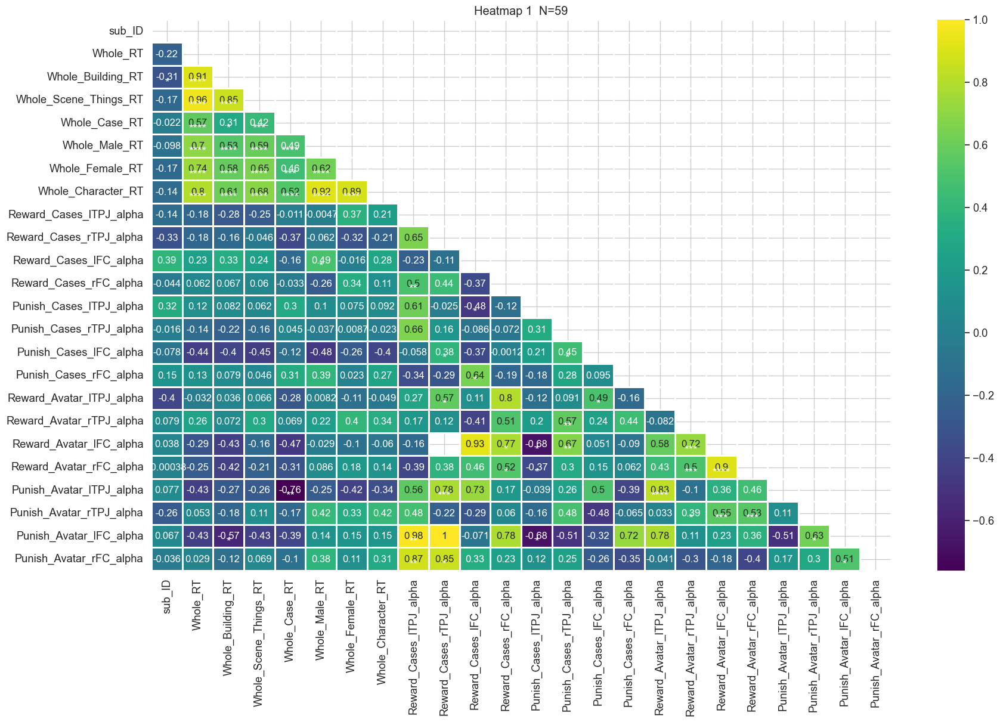

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_mem_whole_RT ,approach_alphaband_list, location='plot_test/test_approach_mem_RT_alpha')

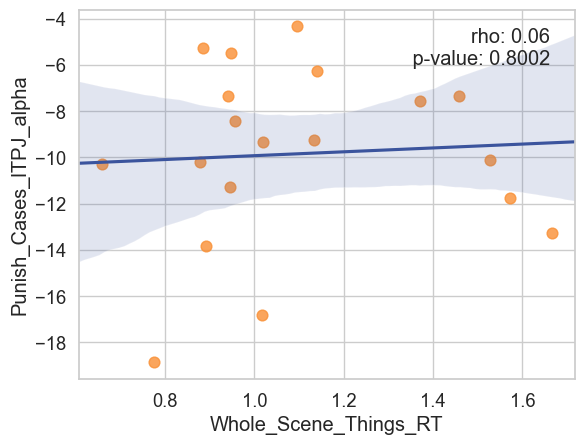

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('Whole_Scene_Things_RT','Punish_Cases_lTPJ_alpha',c,row=0,col=0,ind=0,save =False)

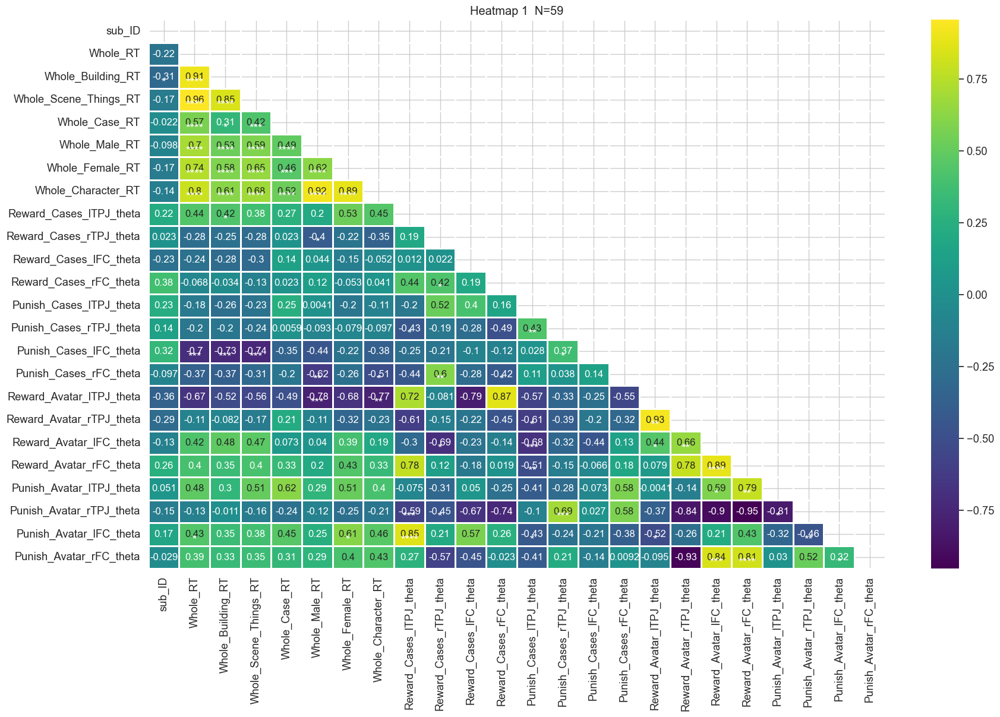

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_mem_whole_RT ,approach_thetaband_list, location='plot_test/test_approach_mem_RT_theta')


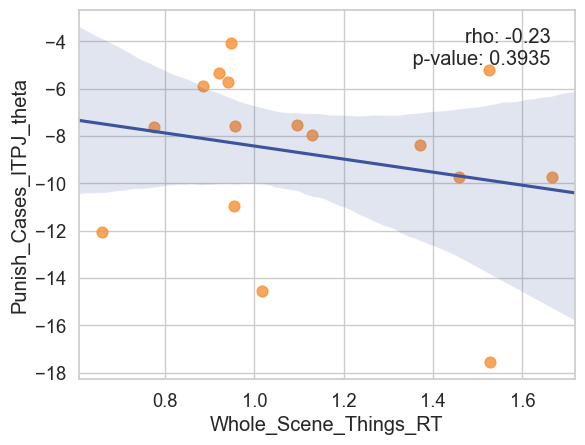

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('Whole_Scene_Things_RT','Punish_Cases_lTPJ_theta',c,row=0,col=0,ind=0,save =False)

8. test power data and nav_arrangement_day1 (distance error)

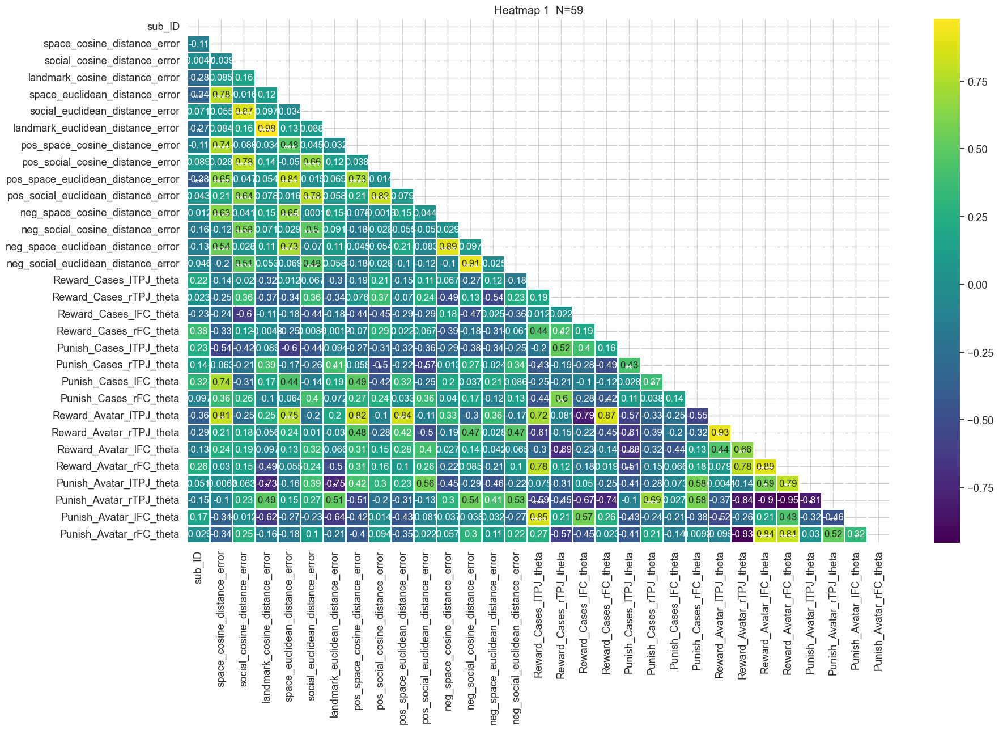

In [ ]:
# c = generate_corrmap(behdata, asydata_cropped, nav_arrd1 ,asydatalist, location='plot_rest/rest_asy_arranged1')
# c = generate_corrmap(behdata, approach_bandata, nav_mem_whole_RT ,approach_thetaband_list, location='plot_test/test_mem_RT_theta')
c = generate_corrmap(behdata, approach_bandata, nav_arrd1 ,approach_thetaband_list, location='plot_test/test_approach_arranged1_theta')

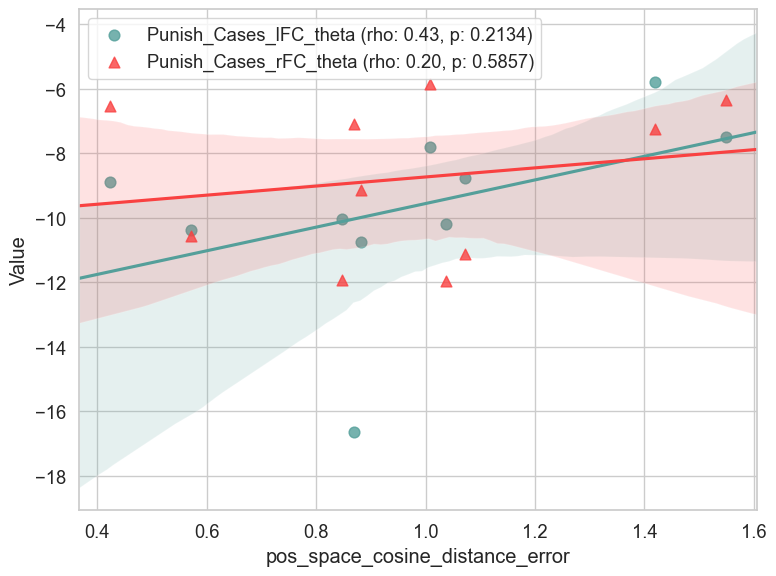

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg_single_y('pos_space_cosine_distance_error','Punish_Cases_lFC_theta','Punish_Cases_rFC_theta', c, save=False)

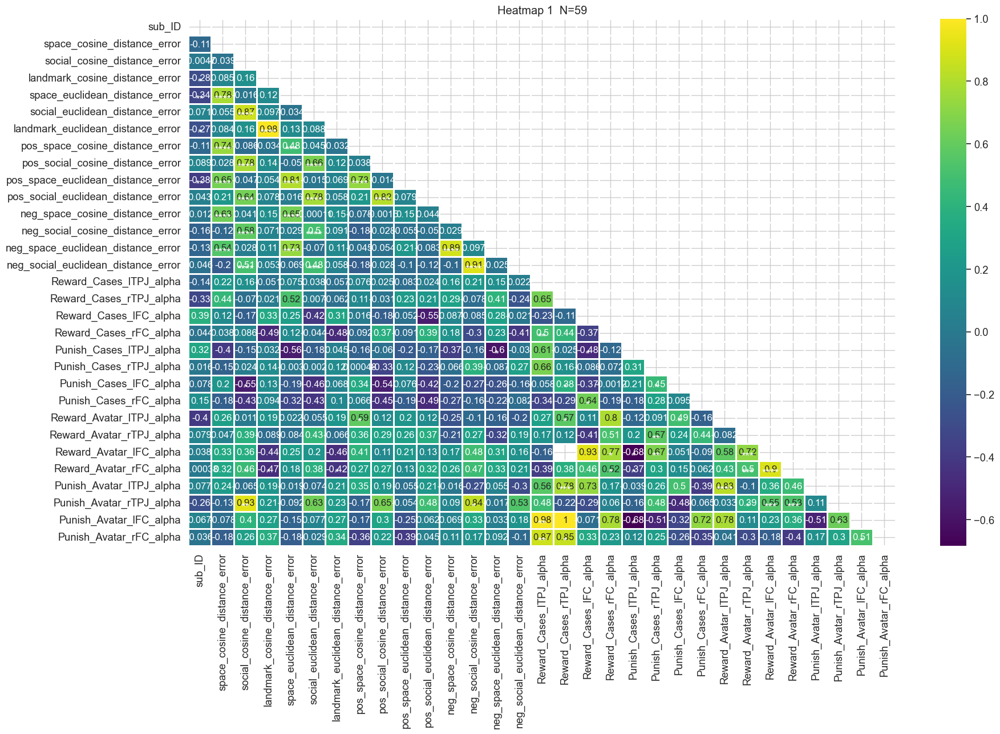

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_arrd1 ,approach_alphaband_list, location='plot_test/test_approach_arranged1_alpha')

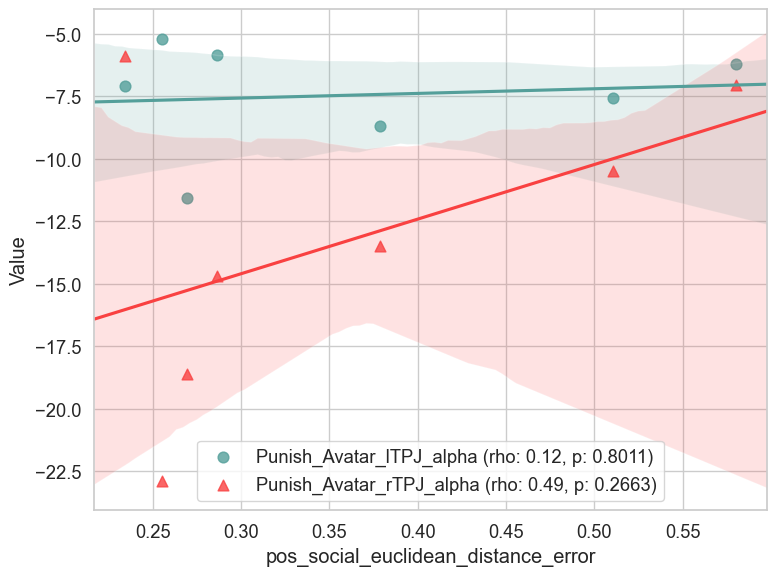

<Figure size 640x480 with 0 Axes>

In [ ]:
# plot_reg('pos_social_euclidean_distance_error','Punish_Avatar_lTPJ_alpha',c,row=0,col=0,ind=0,save =False)

plot_reg_single_y('pos_social_euclidean_distance_error','Punish_Avatar_lTPJ_alpha','Punish_Avatar_rTPJ_alpha', c, save=False)

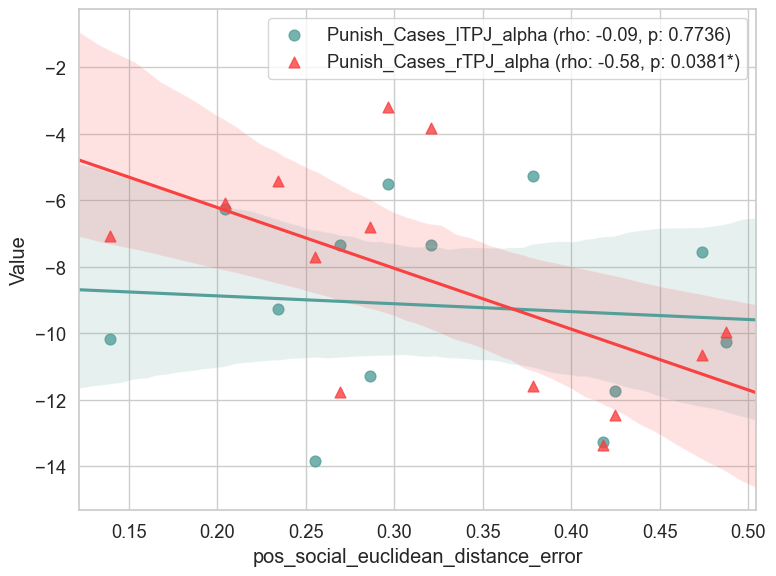

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg_single_y('pos_social_euclidean_distance_error','Punish_Cases_lTPJ_alpha','Punish_Cases_rTPJ_alpha', c, save=False)

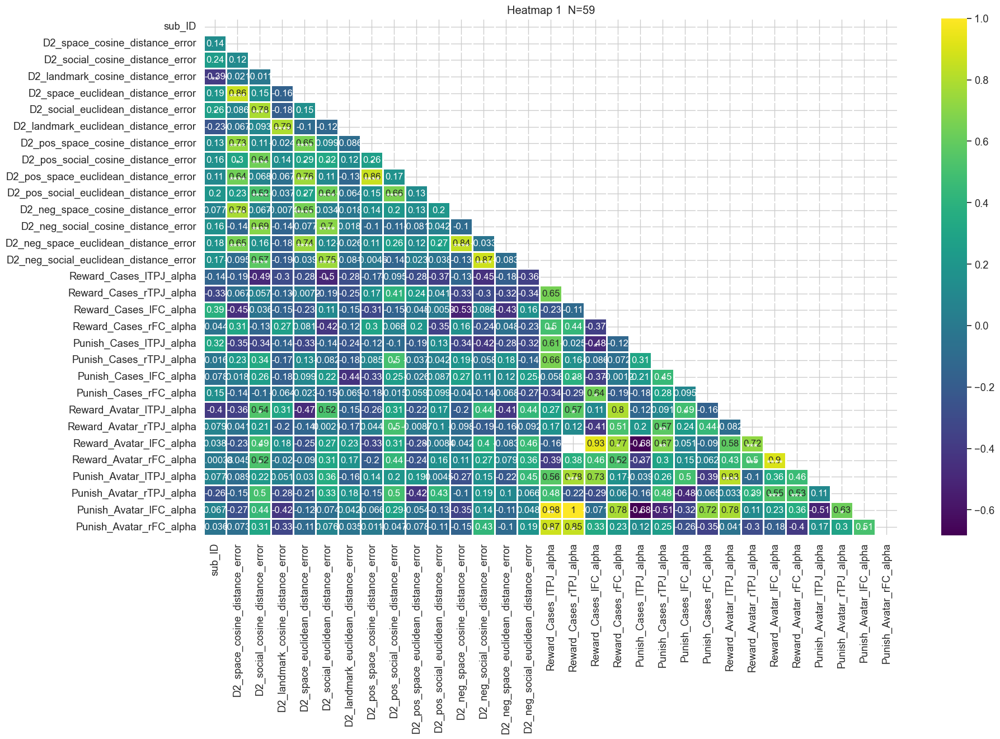

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_arrd2 ,approach_alphaband_list, location='plot_test/test_approach_arranged2_alpha')

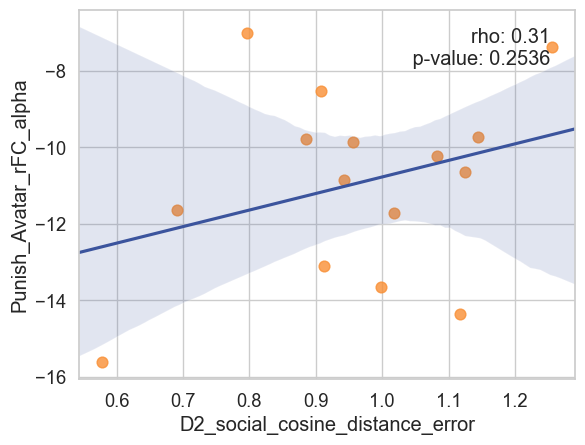

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('D2_social_cosine_distance_error','Punish_Avatar_rFC_alpha',c,row=0,col=0,ind=0,save =False)

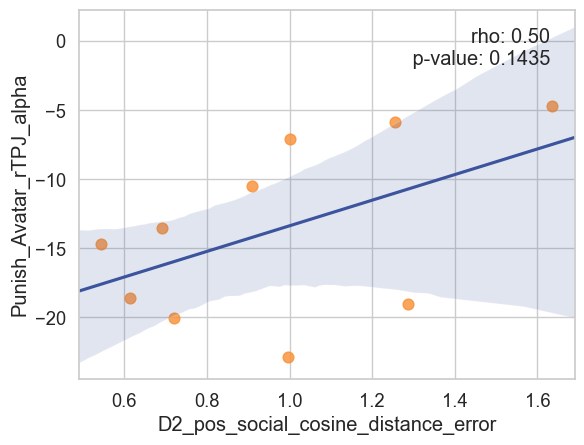

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('D2_pos_social_cosine_distance_error','Punish_Avatar_rTPJ_alpha',c,row=0,col=0,ind=0,save =False)

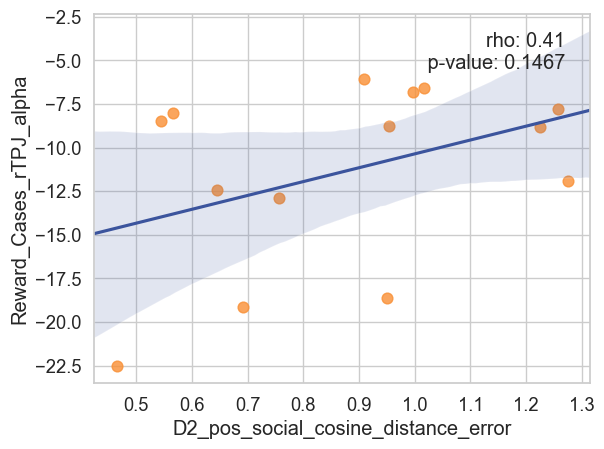

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('D2_pos_social_cosine_distance_error','Reward_Cases_rTPJ_alpha',c,row=0,col=0,ind=0,save =False)

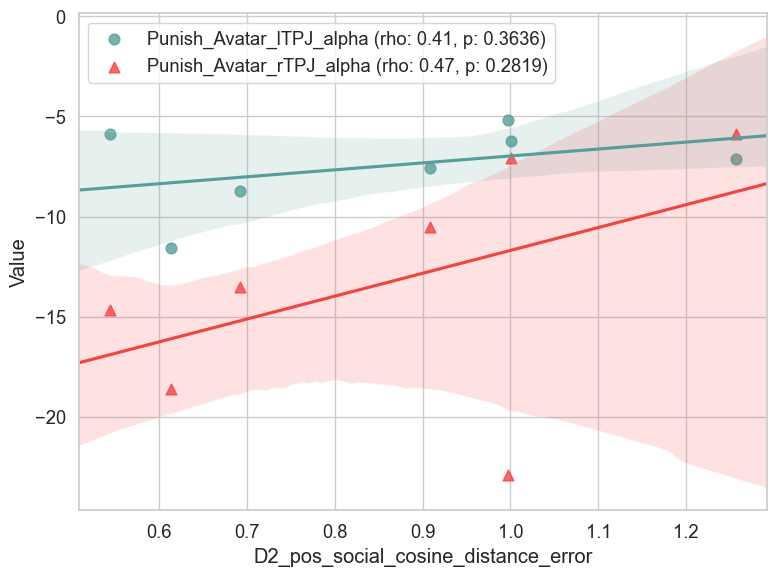

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg_single_y('D2_pos_social_cosine_distance_error','Punish_Avatar_lTPJ_alpha','Punish_Avatar_rTPJ_alpha', c, save=False)

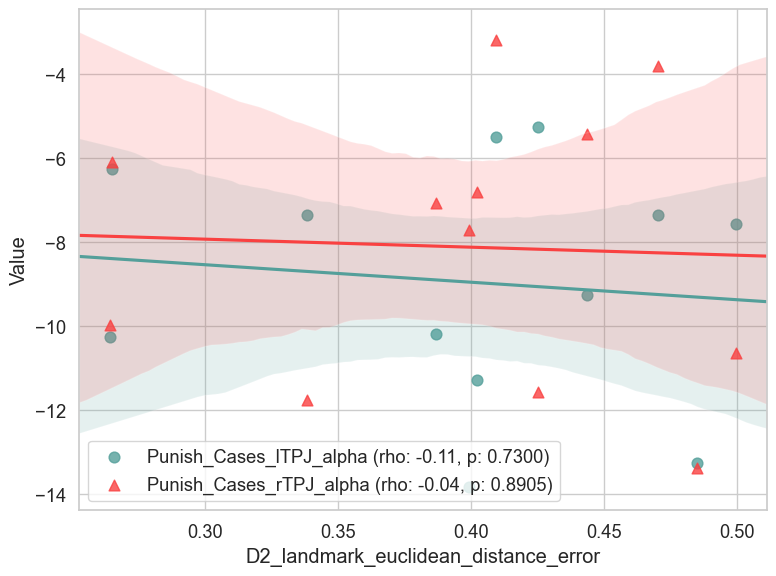

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg_single_y('D2_landmark_euclidean_distance_error','Punish_Cases_lTPJ_alpha','Punish_Cases_rTPJ_alpha', c, save=False)

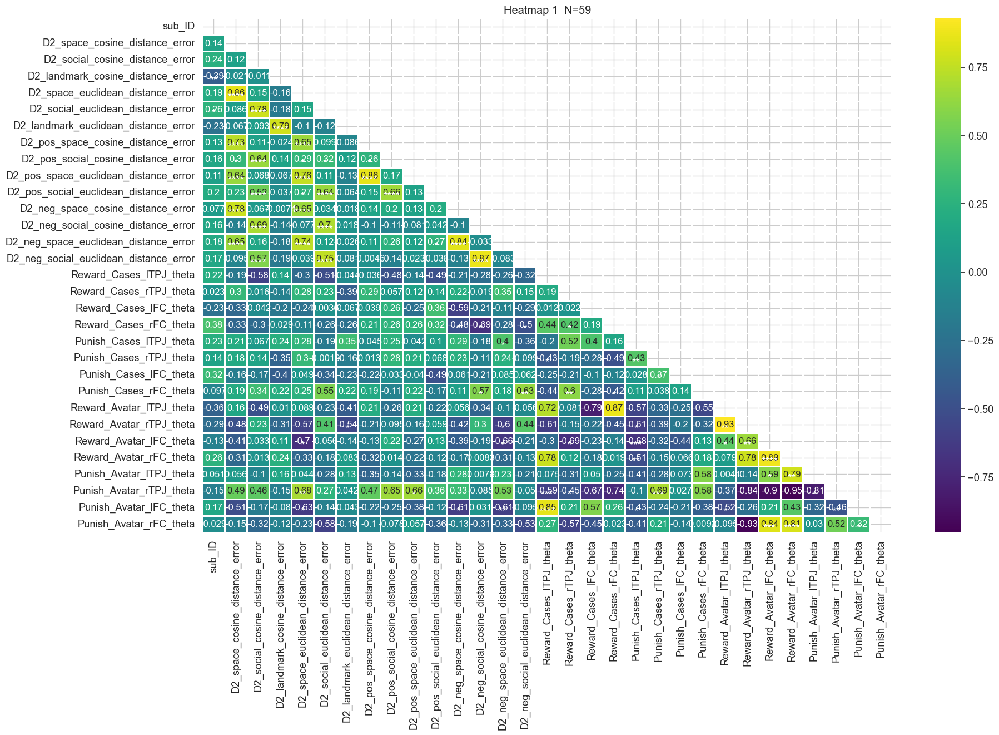

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_arrd2 ,approach_thetaband_list, location='plot_test/test_approach_arranged2_theta')

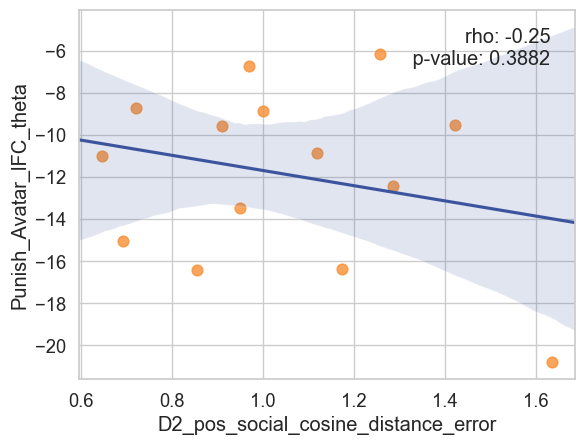

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('D2_pos_social_cosine_distance_error','Punish_Avatar_lFC_theta',c,row=0,col=0,ind=0,save =False)

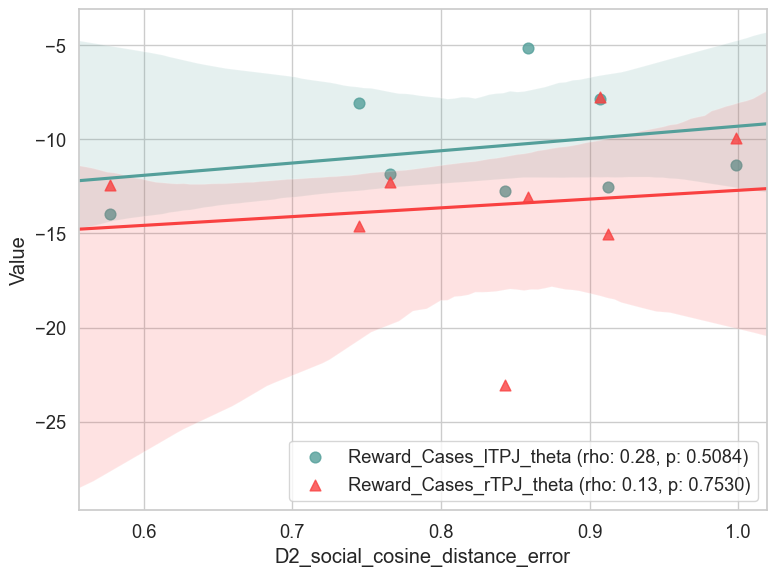

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg_single_y('D2_social_cosine_distance_error','Reward_Cases_lTPJ_theta','Reward_Cases_rTPJ_theta', c, save=False)

9. test power data and nav_pref_day2 (rt/rate)

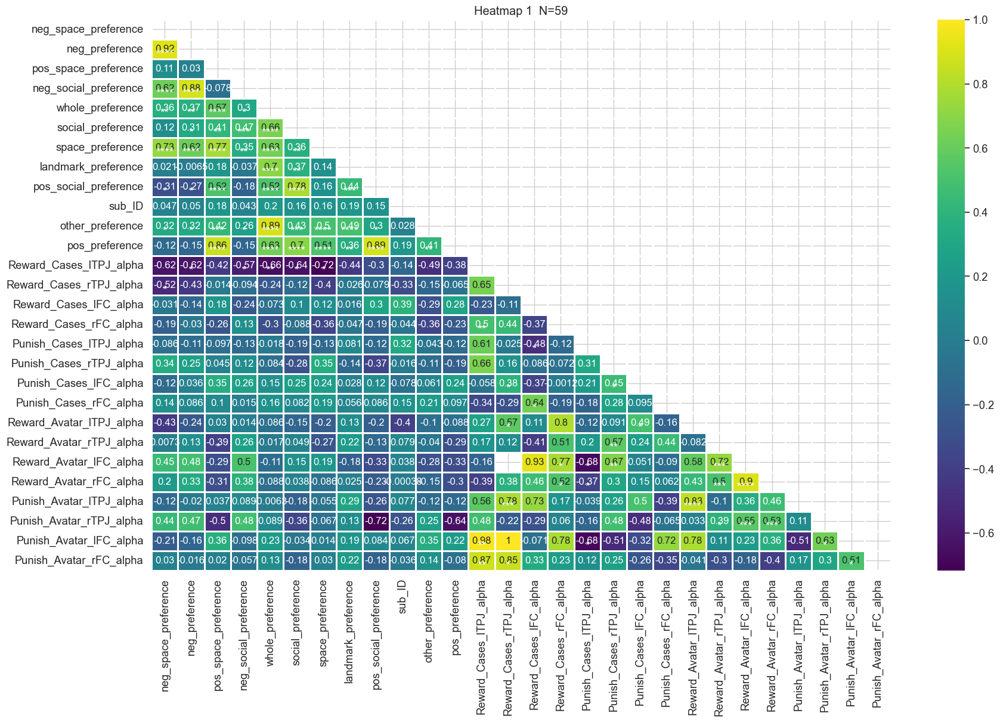

In [ ]:
# c = generate_corrmap(behdata, asydata_cropped, nav_pref ,asydatalist, location='plot_rest/rest_asy_pref')
nav_pref_rate =  [i for i in nav_pref if 'RT' not in i]

c = generate_corrmap(behdata, approach_bandata, nav_pref_rate ,approach_alphaband_list, location='plot_test/test_approach_pref_alpha')

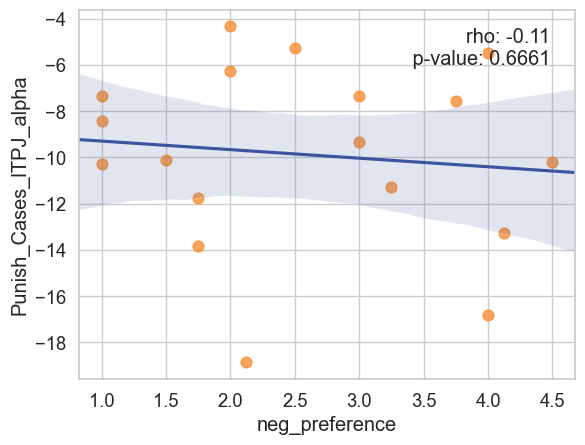

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('neg_preference','Punish_Cases_lTPJ_alpha',c,row=0,col=0,ind=0,save =False)

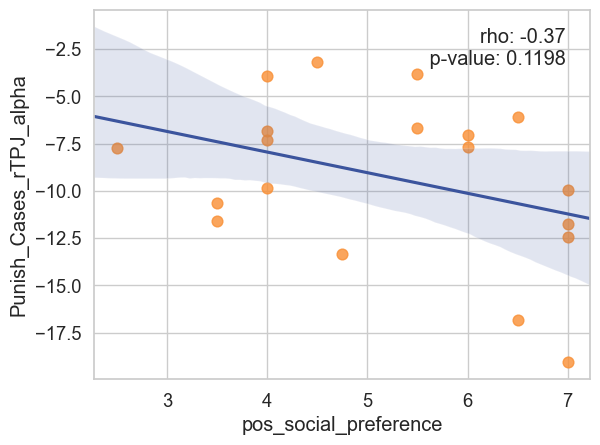

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('pos_social_preference','Punish_Cases_rTPJ_alpha',c,row=0,col=0,ind=0,save =False)

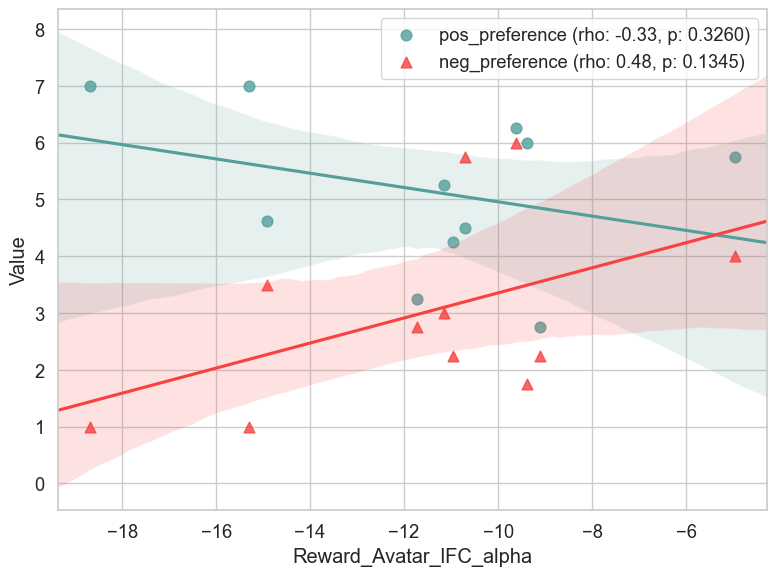

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg_single_y('Reward_Avatar_lFC_alpha','pos_preference','neg_preference', c, save=False)

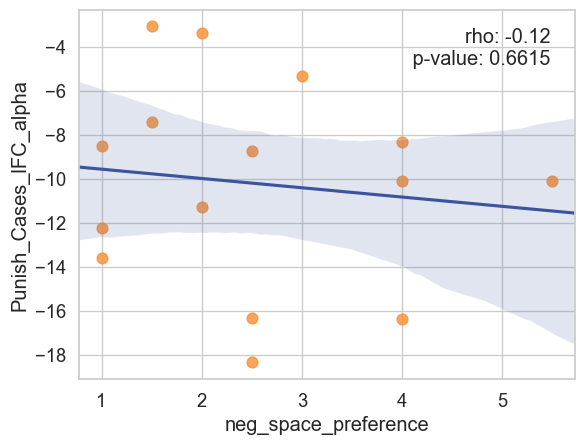

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('neg_space_preference','Punish_Cases_lFC_alpha',c,row=0,col=0,ind=0,save =False)

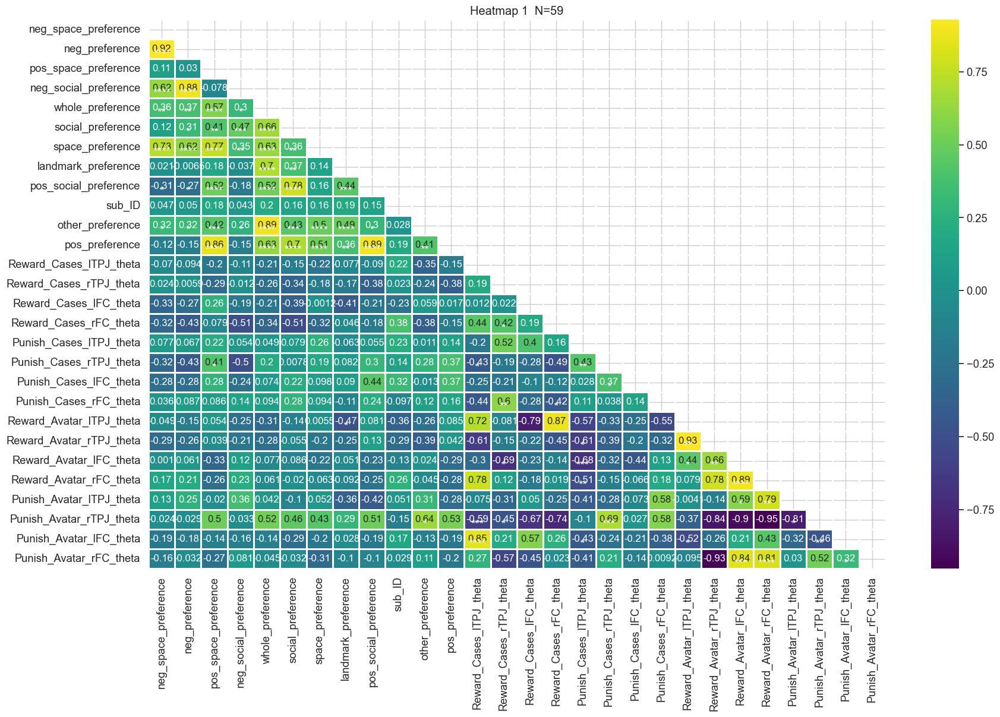

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_pref_rate ,approach_thetaband_list, location='plot_test/test_approach_pref_theta')

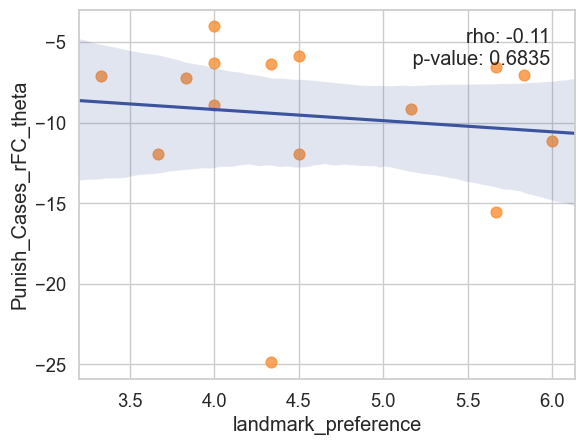

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('landmark_preference','Punish_Cases_rFC_theta',c,row=0,col=0,ind=0,save =False)

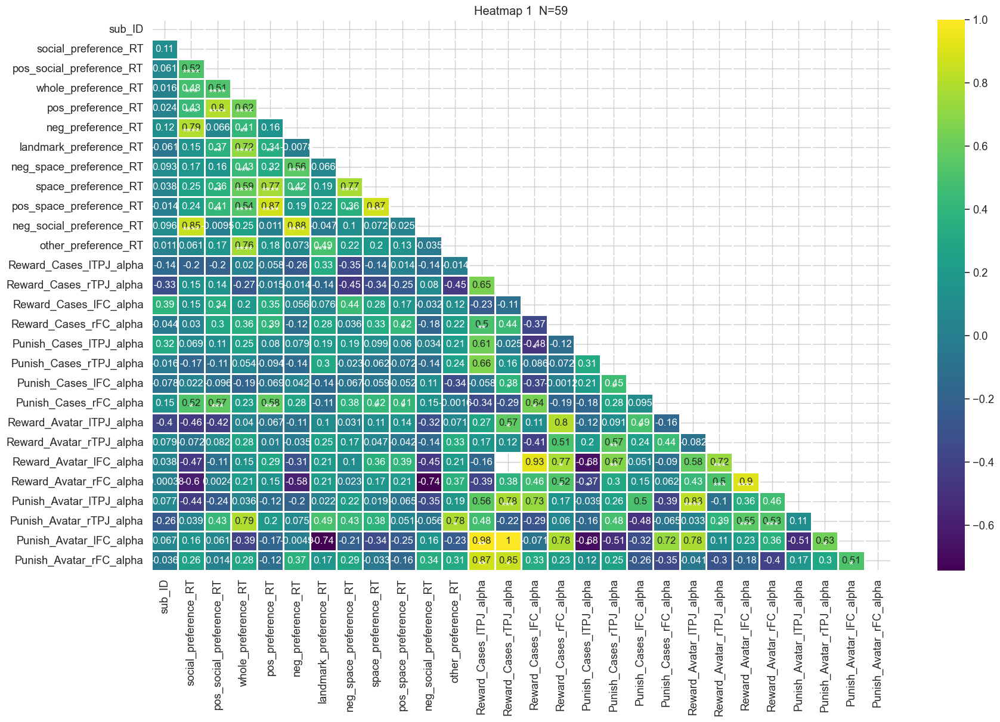

In [ ]:
nav_pref_rateRT =  ['sub_ID']+[i for i in nav_pref if 'RT'  in i]

c = generate_corrmap(behdata, approach_bandata, nav_pref_rateRT ,approach_alphaband_list, location='plot_test/test_approach_pref_RT_alpha')

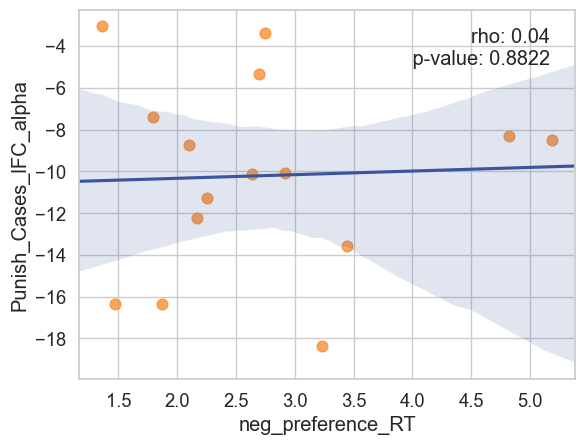

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('neg_preference_RT','Punish_Cases_lFC_alpha',c,row=0,col=0,ind=0,save =False)

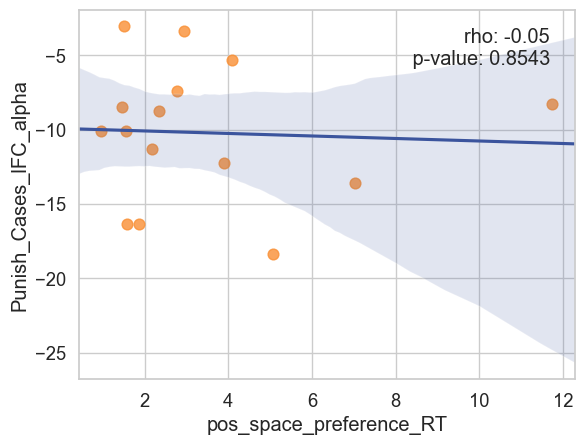

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('pos_space_preference_RT','Punish_Cases_lFC_alpha',c,row=0,col=0,ind=0,save =False)

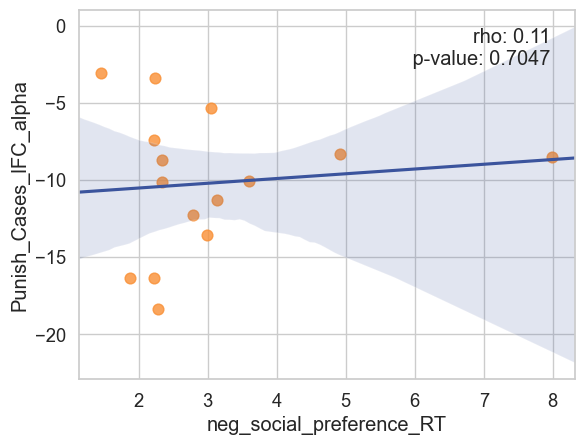

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('neg_social_preference_RT','Punish_Cases_lFC_alpha',c,row=0,col=0,ind=0,save =False)

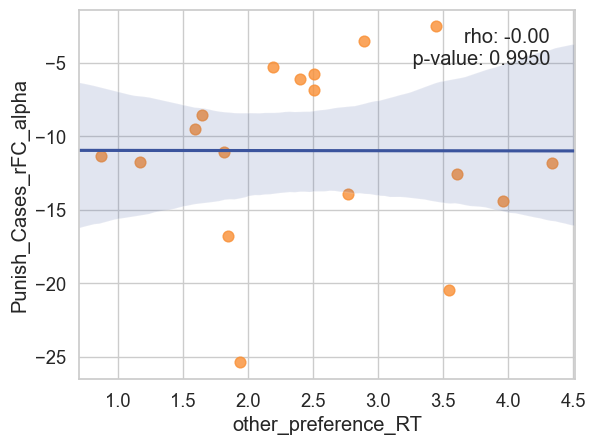

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('other_preference_RT','Punish_Cases_rFC_alpha',c,row=0,col=0,ind=0,save =False)

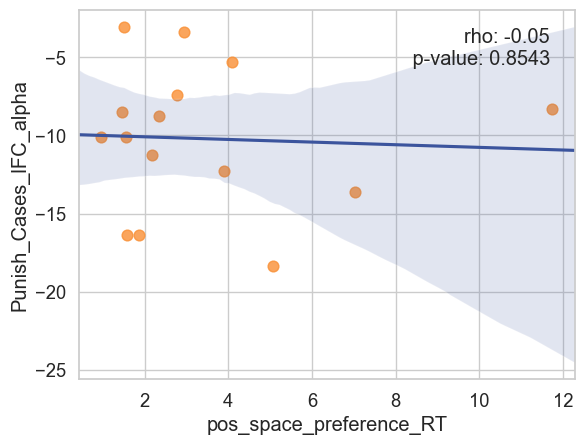

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('pos_space_preference_RT','Punish_Cases_lFC_alpha',c,row=0,col=0,ind=0,save =False)

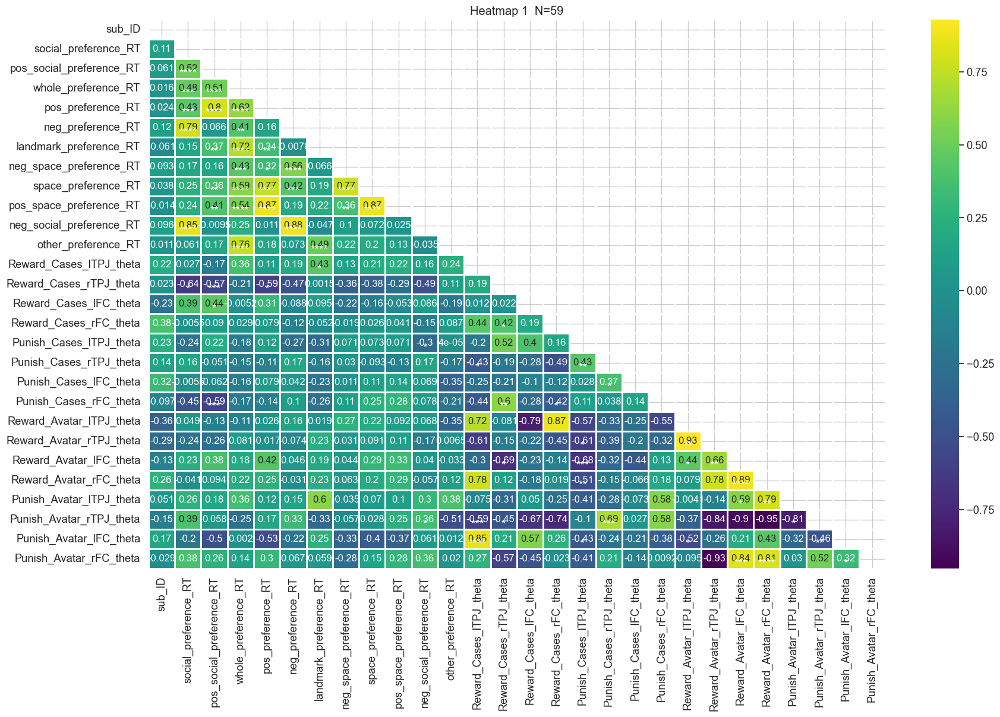

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_pref_rateRT ,approach_thetaband_list, location='plot_test/test_approach_pref_RT_theta')

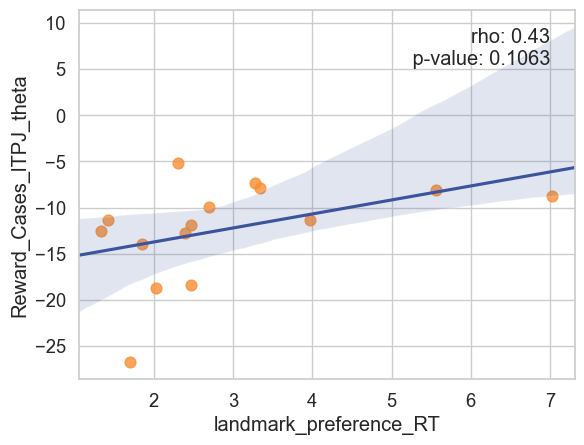

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('landmark_preference_RT','Reward_Cases_lTPJ_theta',c,row=0,col=0,ind=0,save =False)

10. test power data and nav_emotion (valence/arousal)

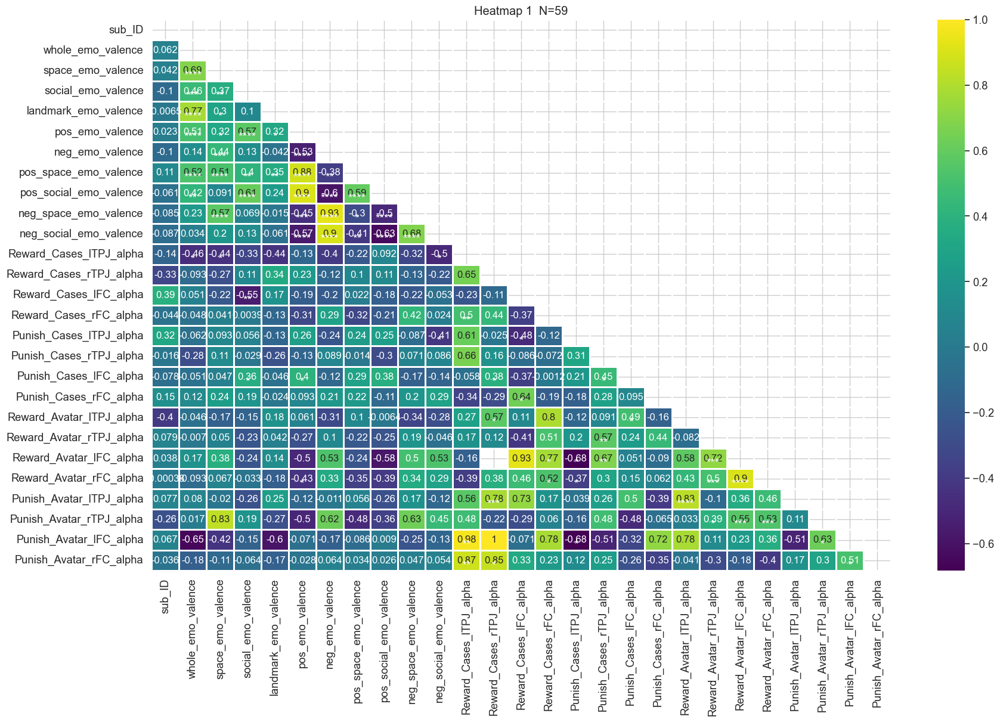

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_emo_v ,approach_alphaband_list, location='plot_test/test_approach_emo_v_alpha')

# c = generate_corrmap(behdata, approach_bandata, nav_pref_rateRT ,approach_thetaband_list, location='plot_test/test_pref_RT_theta')

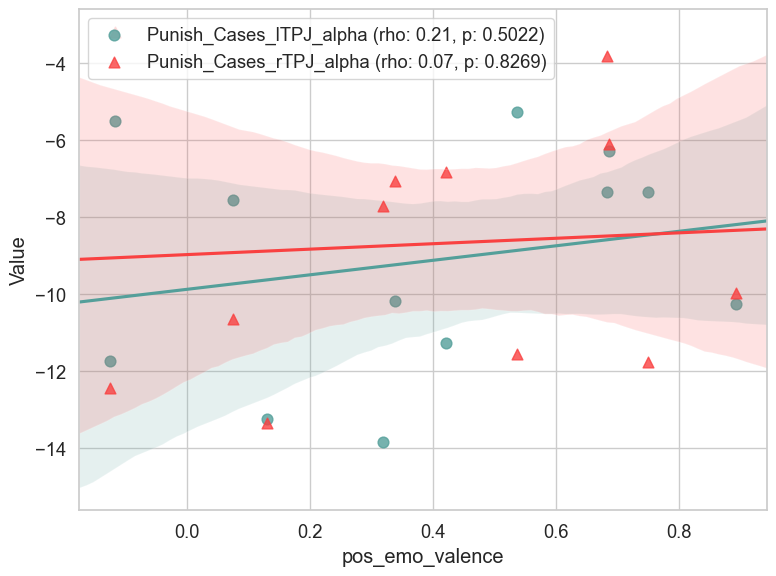

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg_single_y('pos_emo_valence','Punish_Cases_lTPJ_alpha','Punish_Cases_rTPJ_alpha', c, save=False)

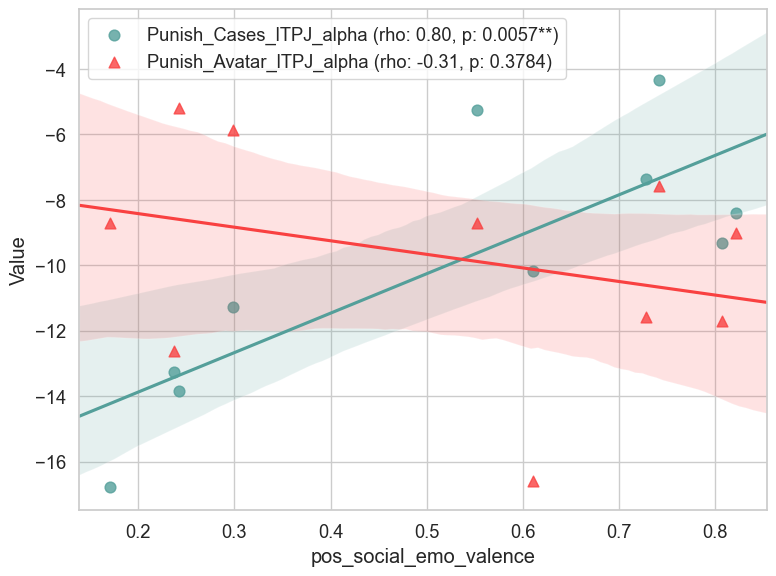

<Figure size 640x480 with 0 Axes>

In [ ]:
# plot_reg('pos_social_emo_valence','Punish_Avatar_lTPJ_alpha',c,row=0,col=0,ind=0,save =False)

plot_reg_single_y('pos_social_emo_valence','Punish_Cases_lTPJ_alpha','Punish_Avatar_lTPJ_alpha', c, save=False)

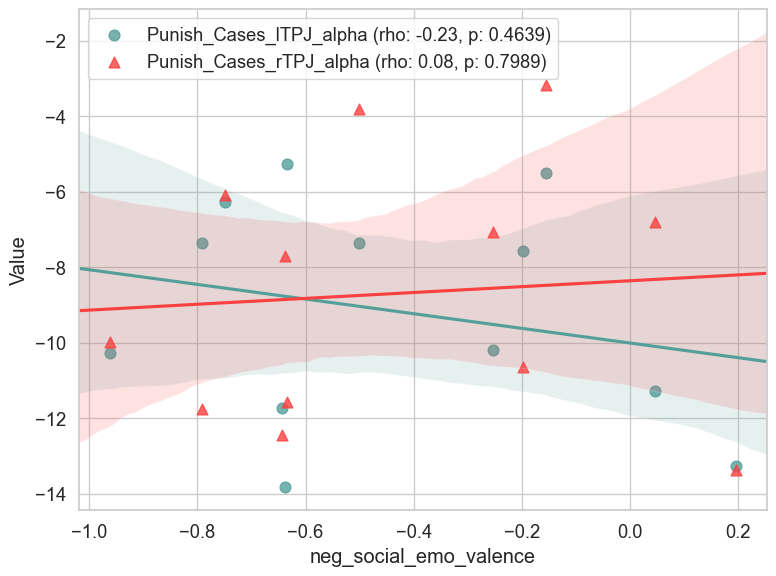

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg_single_y('neg_social_emo_valence','Punish_Cases_lTPJ_alpha','Punish_Cases_rTPJ_alpha', c, save=False)

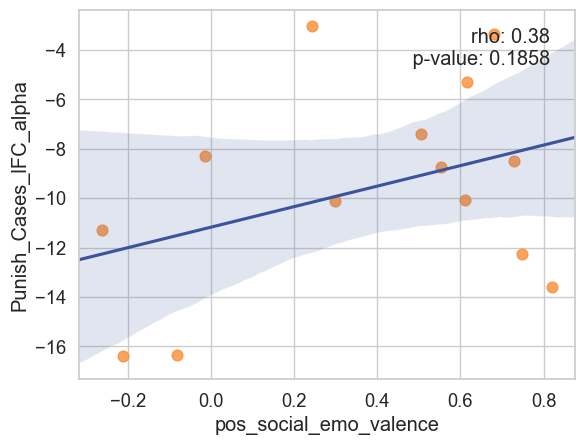

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('pos_social_emo_valence','Punish_Cases_lFC_alpha',c,row=0,col=0,ind=0,save =False)

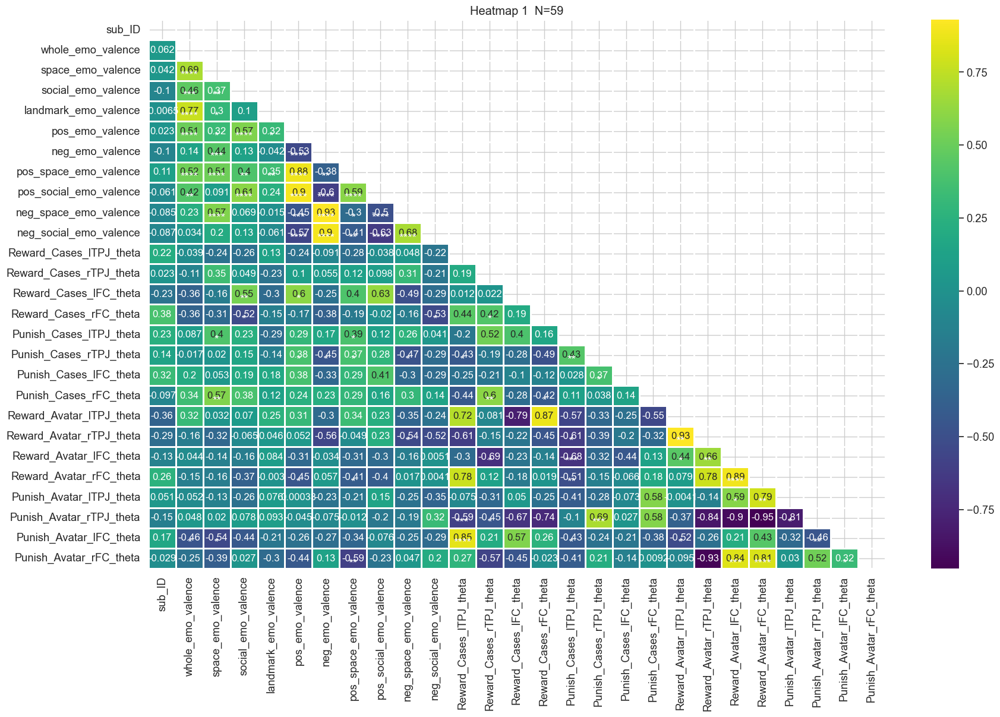

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_emo_v ,approach_thetaband_list, location='plot_test/test_approach_emo_v_theta')

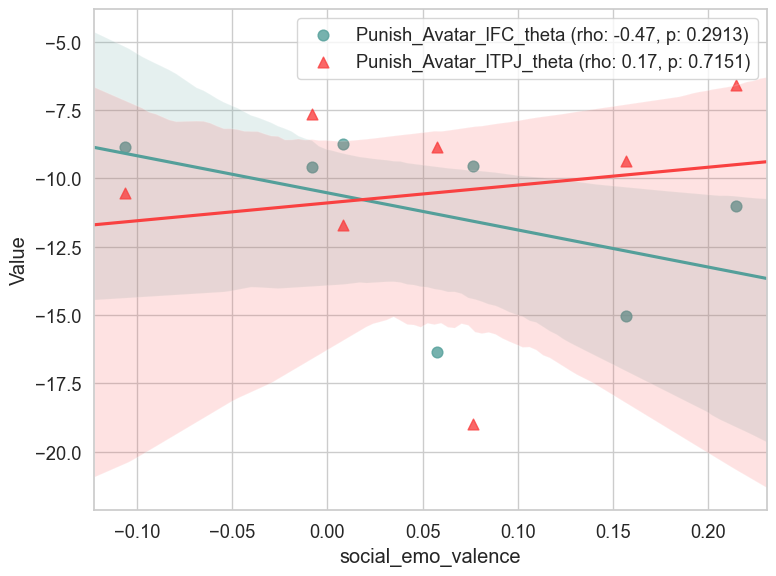

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg_single_y('social_emo_valence','Punish_Avatar_lFC_theta','Punish_Avatar_lTPJ_theta', c, save=False)

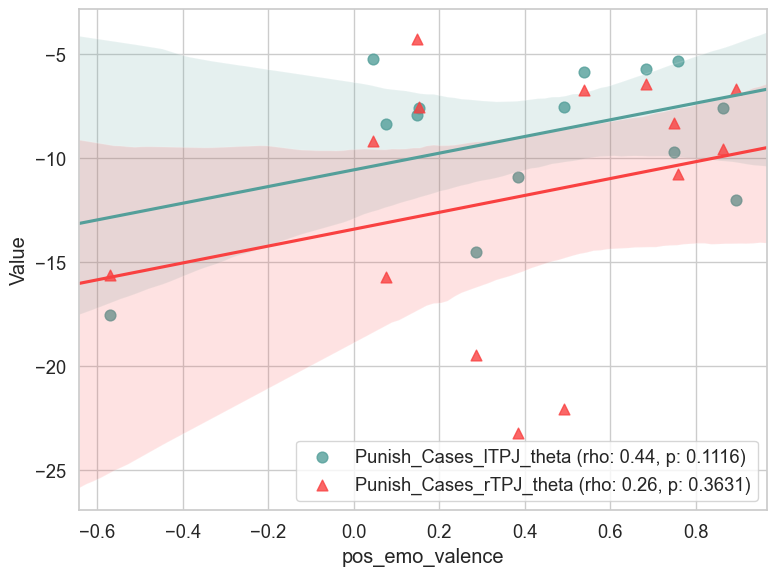

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg_single_y('pos_emo_valence','Punish_Cases_lTPJ_theta','Punish_Cases_rTPJ_theta', c, save=False)

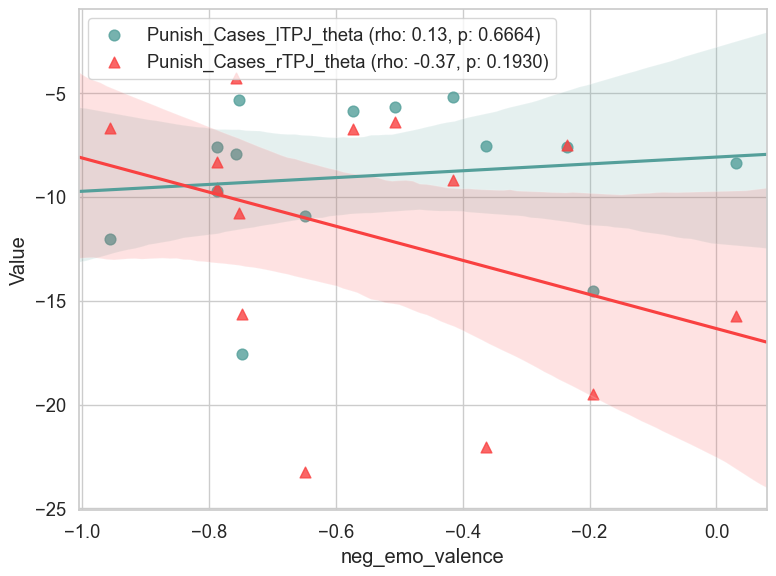

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg_single_y('neg_emo_valence','Punish_Cases_lTPJ_theta','Punish_Cases_rTPJ_theta', c, save=False)

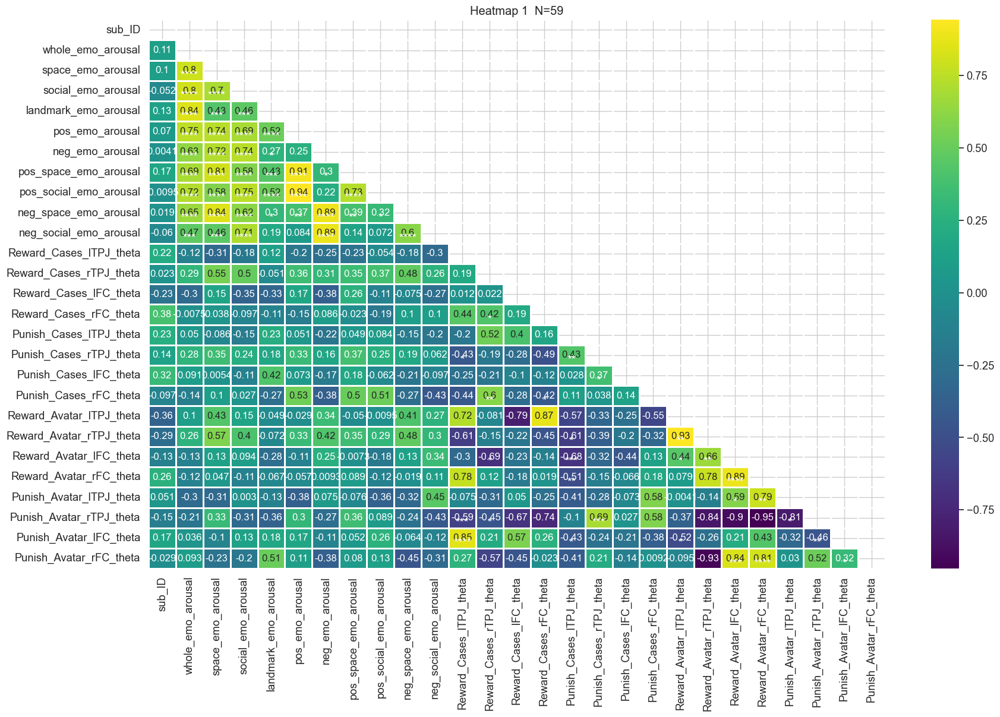

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_emo_a ,approach_thetaband_list, location='plot_test/test_approach_emo_a_theta')

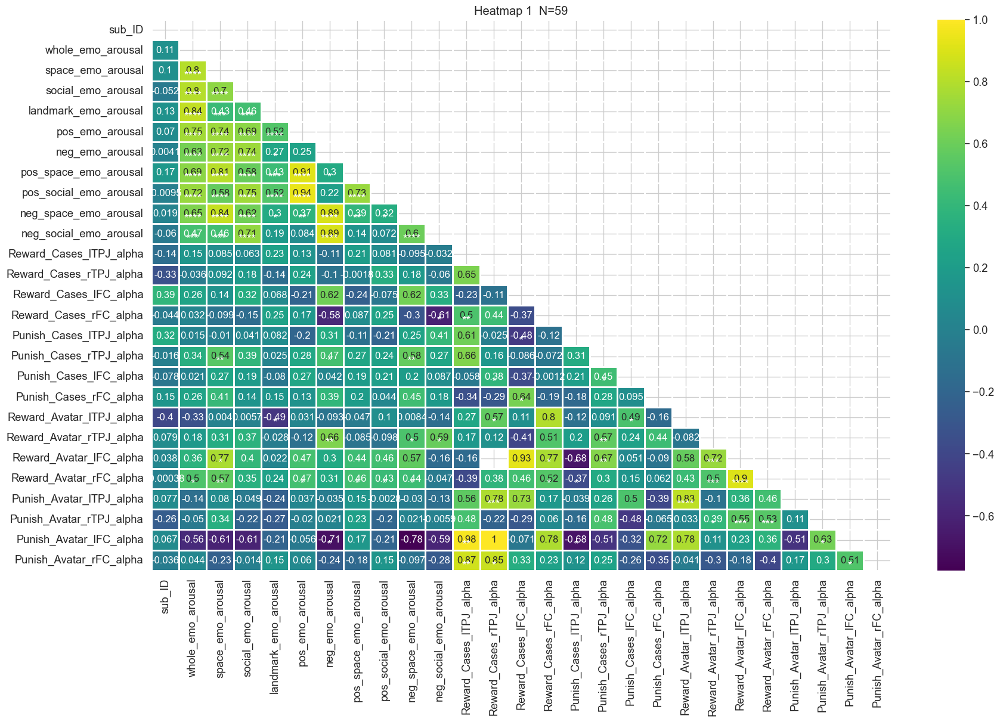

In [ ]:
c = generate_corrmap(behdata, approach_bandata, nav_emo_a ,approach_alphaband_list, location='plot_test/test_approach_emo_a_alpha')

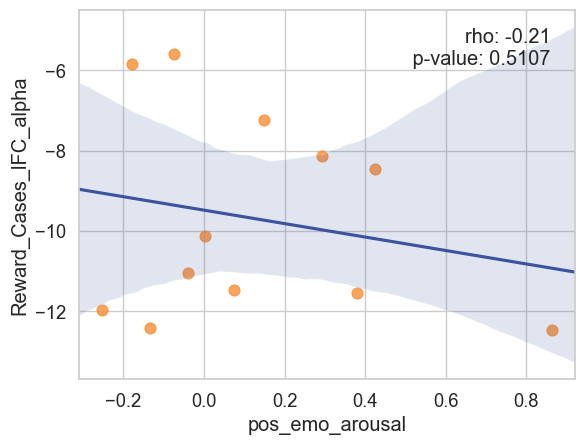

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('pos_emo_arousal','Reward_Cases_lFC_alpha',c,row=0,col=0,ind=0,save =False)

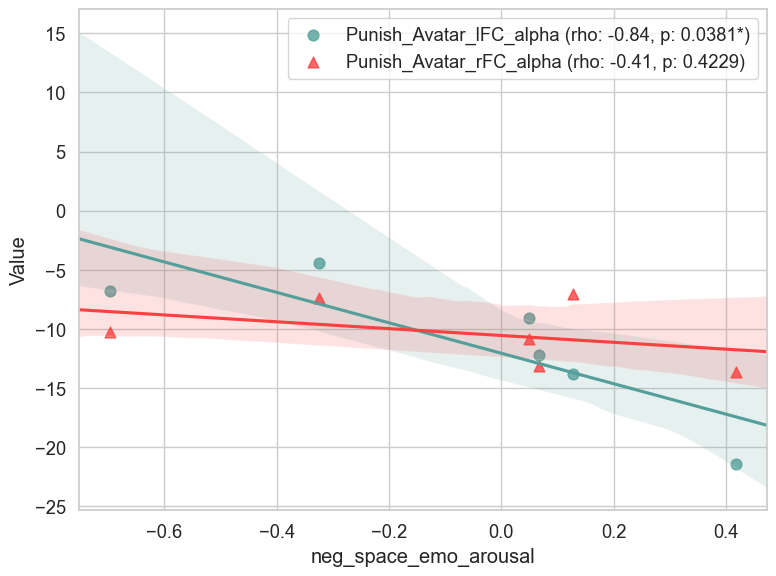

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg_single_y('neg_space_emo_arousal','Punish_Avatar_lFC_alpha','Punish_Avatar_rFC_alpha', c, save=False)

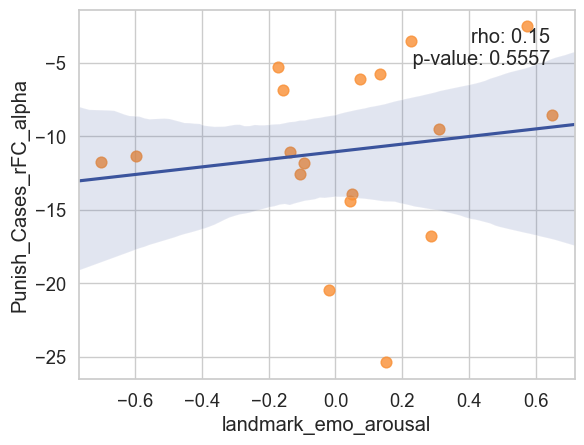

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('landmark_emo_arousal','Punish_Cases_rFC_alpha',c,row=0,col=0,ind=0,save =False)

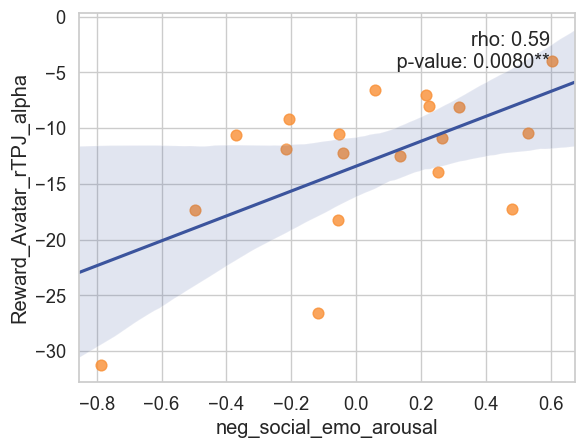

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('neg_social_emo_arousal','Reward_Avatar_rTPJ_alpha',c,row=0,col=0,ind=0,save =False)

11. test power data and asymmetry data

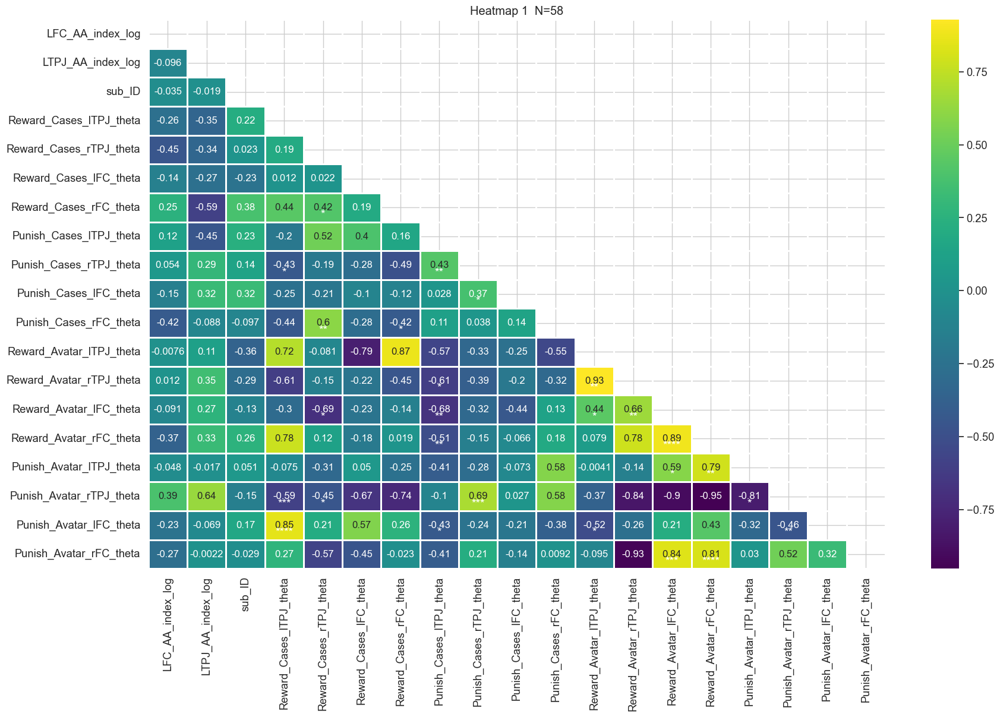

In [ ]:
asydatalist = asydata_cropped.columns.to_list()
asydatalist

c = generate_corrmap(asydata_cropped, approach_bandata, asydatalist ,approach_thetaband_list, location='plot_test/test_approach_asydatalist_theta')

# c = generate_corrmap(behdata, asydata_cropped, nav_emo_a ,asydatalist, location='plot_rest/rest_asy_emo_a')

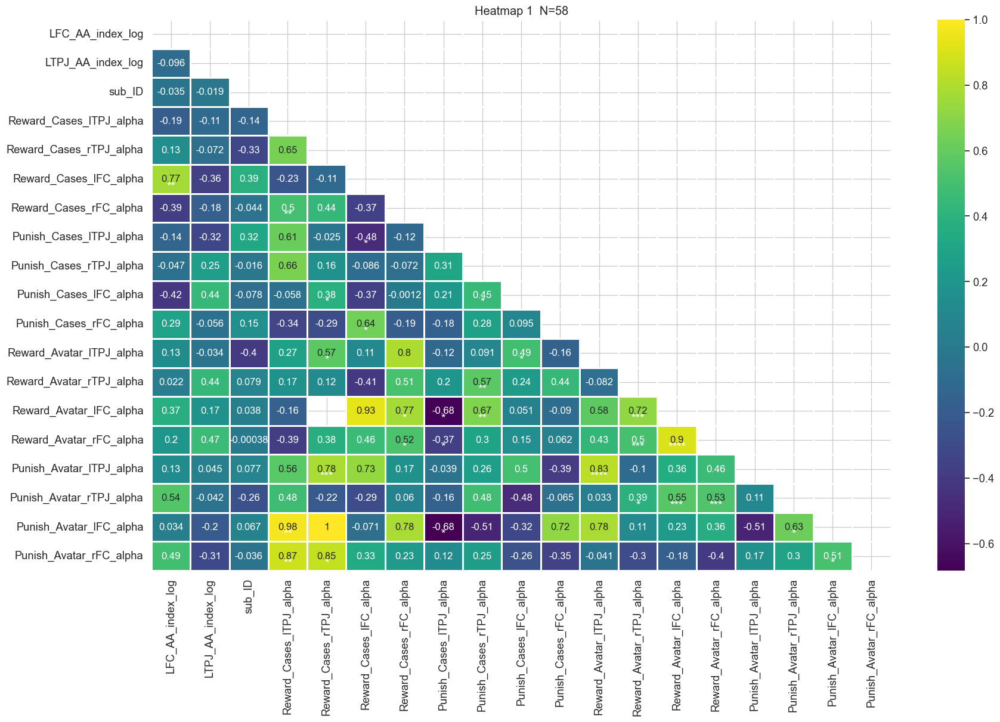

In [ ]:
c = generate_corrmap(asydata_cropped, approach_bandata, asydatalist ,approach_alphaband_list, location='plot_test/test_approach_asydatalist_alpha')

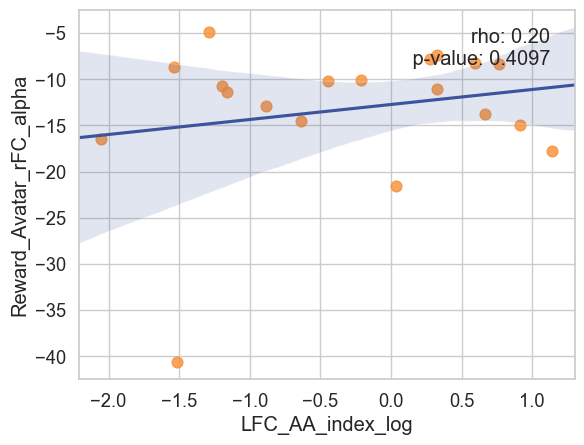

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('LFC_AA_index_log','Reward_Avatar_rFC_alpha',c,row=0,col=0,ind=0,save =False)

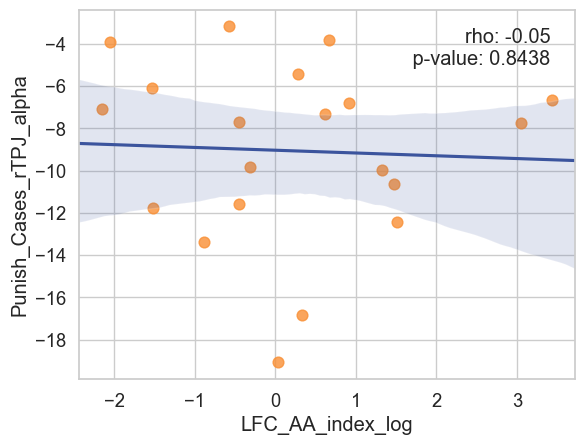

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('LFC_AA_index_log','Punish_Cases_rTPJ_alpha',c,row=0,col=0,ind=0,save =False)

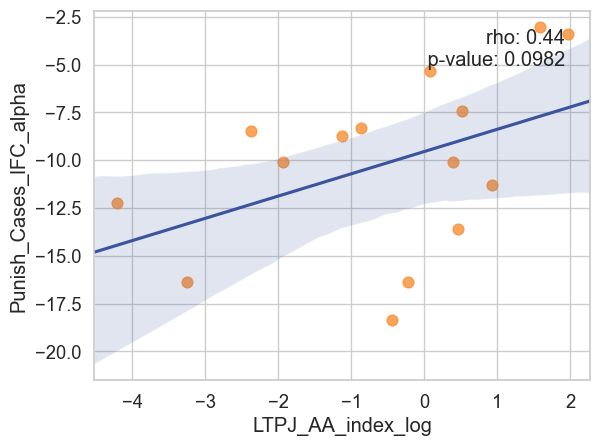

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_reg('LTPJ_AA_index_log','Punish_Cases_lFC_alpha',c,row=0,col=0,ind=0,save =False)